<a href="https://colab.research.google.com/github/aeyeniay/AdvancedProject2/blob/main/AP_Tirta/Scenario%202/AP_Tirta_2019_2021_v2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## 1. Library

In [1]:
pip install --upgrade pandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
pip install --upgrade matplotlib

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [3]:
!pip install shap

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [4]:
pip install lime

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [5]:
%matplotlib inline
from warnings import simplefilter
import numpy as np 
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt 
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error,r2_score,mean_squared_error,mean_absolute_percentage_error
from sklearn.ensemble import RandomForestRegressor
import shap
import lime
from lime import lime_tabular
shap.initjs()

In [6]:
def eval(evaluation,y_true,y_train_pred,name):
  a_dict = {}
  a_dict['MAE'] = mean_absolute_error(y_true,y_train_pred)
  a_dict['MSE'] = mean_squared_error(y_true,y_train_pred)
  a_dict['MAPE']= round(mean_absolute_percentage_error(y_true,y_train_pred),6)
  a_dict['R squared'] = r2_score(y_true,y_train_pred)
  a_dict['RMSE'] = np.sqrt(mean_squared_error(y_true,y_train_pred))
  a_dict['RMSLE'] = np.log(np.sqrt(mean_squared_error(y_true,y_train_pred)))
  evaluation[name] = a_dict

## 2. Dataset

In [7]:
df = pd.read_csv(
    "Rice-Data-2018-2021.csv",
    index_col='Date',
    parse_dates=['Date'],
)

df.head()

,Average Price of Premium Quality Rice,Average Price of Medium Quality Rice,Average Price of Bad Quality Rice,Harvest Area (10^6 ha),Produksi Padi Nasional (10^6 Ton),Produksi Beras Nasional (10^6 Ton),Productivity (ku/ha)
Date,,,,,,,
2018-01-01,10349.91,10177.05,9792.59,0.54,2.78,1.59,51.48
2018-02-01,10381.74,10215.16,9987.10,1.07,5.74,3.29,53.64
2018-03-01,9892.56,9698.23,9554.06,1.77,9.68,5.55,54.69
2018-04-01,9524.96,9220.84,8991.36,1.41,7.60,4.36,53.90
2018-05-01,9523.88,9190.37,9001.50,1.00,4.90,2.81,49.00


In this scenario I will only take data from 2019-2021

In [8]:
df = df.iloc[12:,:]

# 3. Exploratory Data Analysis (EDA)

Since this date is an important part of knowing when at certain intervals the rice price increases or decreases, we want to predict the possible dates or date ranges when the next data might occur And also because the algorithm cannot directly handle dates, let's extract some simple features from the date such as month and year, and omit the original date column. The Data Series column that will be created is the value of the sequence of numbers from when the data is obtained

In [9]:
df['Date'] = df.index
df['Date'] = pd.to_datetime(df['Date'], format='%Y-%m-%d') 
df['Year']= df['Date'].dt.year
df['Month'] = df['Date'].dt.month
df['Series'] = np.arange(1,len(df.index)+1)
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 36 entries, 2019-01-01 to 2021-12-01
Data columns (total 11 columns):
 #   Column                                 Non-Null Count  Dtype         
---  ------                                 --------------  -----         
 0   Average Price of Premium Quality Rice  36 non-null     float64       
 1   Average Price of Medium Quality Rice   36 non-null     float64       
 2   Average Price of Bad Quality Rice      36 non-null     float64       
 3   Harvest Area (10^6 ha)                 36 non-null     float64       
 4   Produksi Padi Nasional (10^6 Ton)      36 non-null     float64       
 5   Produksi Beras Nasional (10^6 Ton)     36 non-null     float64       
 6   Productivity (ku/ha)                   36 non-null     float64       
 7   Date                                   36 non-null     datetime64[ns]
 8   Year                                   36 non-null     int64         
 9   Month                                  36 non-n

In [10]:
df = df.drop(columns=['Date'])

In [11]:
df

,Average Price of Premium Quality Rice,Average Price of Medium Quality Rice,Average Price of Bad Quality Rice,Harvest Area (10^6 ha),Produksi Padi Nasional (10^6 Ton),Produksi Beras Nasional (10^6 Ton),Productivity (ku/ha),Year,Month,Series
Date,,,,,,,,,,
2019-01-01,10111.08,9902.68,9536.30,0.41,2.04,1.17,49.76,2019,1,1
2019-02-01,10007.91,9799.57,9474.50,0.73,3.63,2.08,49.73,2019,2,2
2019-03-01,9814.53,9555.35,9271.13,1.72,9.17,5.25,53.31,2019,3,3
2019-04-01,9464.68,9144.20,8936.36,1.68,8.94,5.12,53.21,2019,4,4
2019-05-01,9462.05,9142.52,8953.33,0.92,4.37,2.50,47.50,2019,5,5
2019-06-01,9515.51,9166.40,9011.62,0.88,4.31,2.47,48.98,2019,6,6
2019-07-01,9519.35,9211.03,8931.02,0.95,4.64,2.66,48.84,2019,7,7
2019-08-01,9530.00,9224.00,9048.00,1.18,5.60,3.21,47.46,2019,8,8
2019-09-01,9594.39,9301.08,9140.60,0.80,4.23,2.43,52.88,2019,9,9


In [12]:
df.describe()

,Average Price of Premium Quality Rice,Average Price of Medium Quality Rice,Average Price of Bad Quality Rice,Harvest Area (10^6 ha),Produksi Padi Nasional (10^6 Ton),Produksi Beras Nasional (10^6 Ton),Productivity (ku/ha),Year,Month,Series
count,36.000000,36.000000,36.000000,36.000000,36.000000,36.000000,36.000000,36.000000,36.00000,36.000000
mean,9727.516111,9335.824167,9018.168611,0.879444,4.550556,2.610833,53.344722,2020.000000,6.50000,18.500000
std,212.723329,292.264972,279.274130,0.427912,2.212809,1.290416,11.235960,0.828079,3.50102,10.535654
min,9401.610000,8886.900000,8481.430000,0.290000,1.620000,0.930000,30.380000,2019.000000,1.00000,1.000000
25%,9535.370000,9139.000000,8851.825000,0.557500,3.200000,1.800000,48.970000,2019.000000,3.75000,9.750000
50%,9728.330000,9358.795000,9000.310000,0.795000,4.110000,2.415000,52.115000,2020.000000,6.50000,18.500000
75%,9883.077500,9523.145000,9170.385000,1.097500,4.857500,3.187500,54.727500,2021.000000,9.25000,27.250000
max,10111.080000,9902.680000,9536.300000,1.860000,9.670000,5.600000,86.380000,2021.000000,12.00000,36.000000


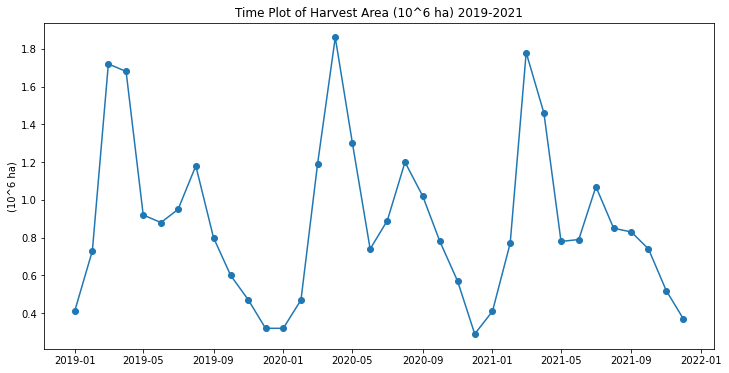

In [13]:
fig = plt.figure(figsize=(12, 6))
plt.plot(df['Harvest Area (10^6 ha)'],marker='o') 
plt.title('Time Plot of Harvest Area (10^6 ha) 2019-2021')
plt.ylabel("(10^6 ha)")
plt.show()

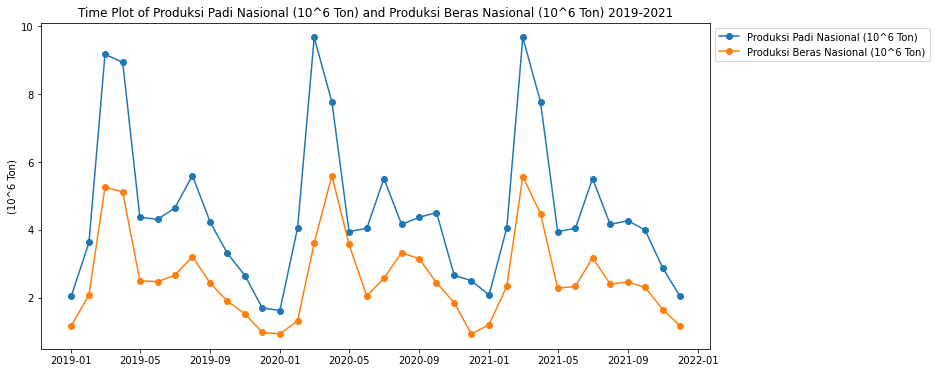

In [14]:
fig = plt.figure(figsize=(12, 6))
plt.plot(df['Produksi Padi Nasional (10^6 Ton)'],marker='o',label = 'Produksi Padi Nasional (10^6 Ton)') 
plt.plot(df['Produksi Beras Nasional (10^6 Ton)'],marker='o',label = 'Produksi Beras Nasional (10^6 Ton)') 
plt.title('Time Plot of Produksi Padi Nasional (10^6 Ton) and Produksi Beras Nasional (10^6 Ton) 2019-2021')
plt.legend(bbox_to_anchor = (1.0, 1), loc = 'upper left')
plt.ylabel("(10^6 Ton)")
plt.show()

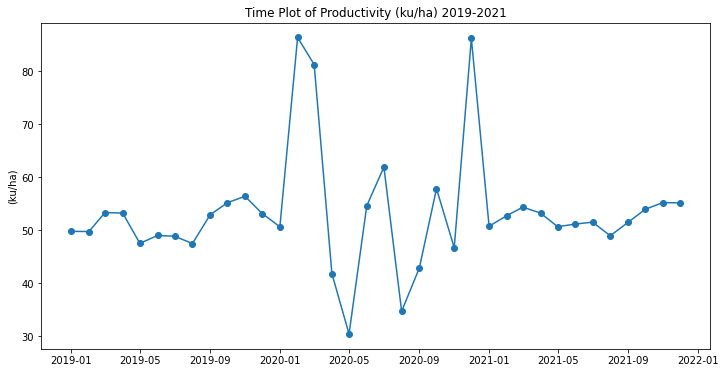

In [15]:
fig = plt.figure(figsize=(12, 6))
plt.plot(df['Productivity (ku/ha)'],marker='o') 
plt.title('Time Plot of Productivity (ku/ha) 2019-2021')
plt.ylabel("(ku/ha)")
plt.show()

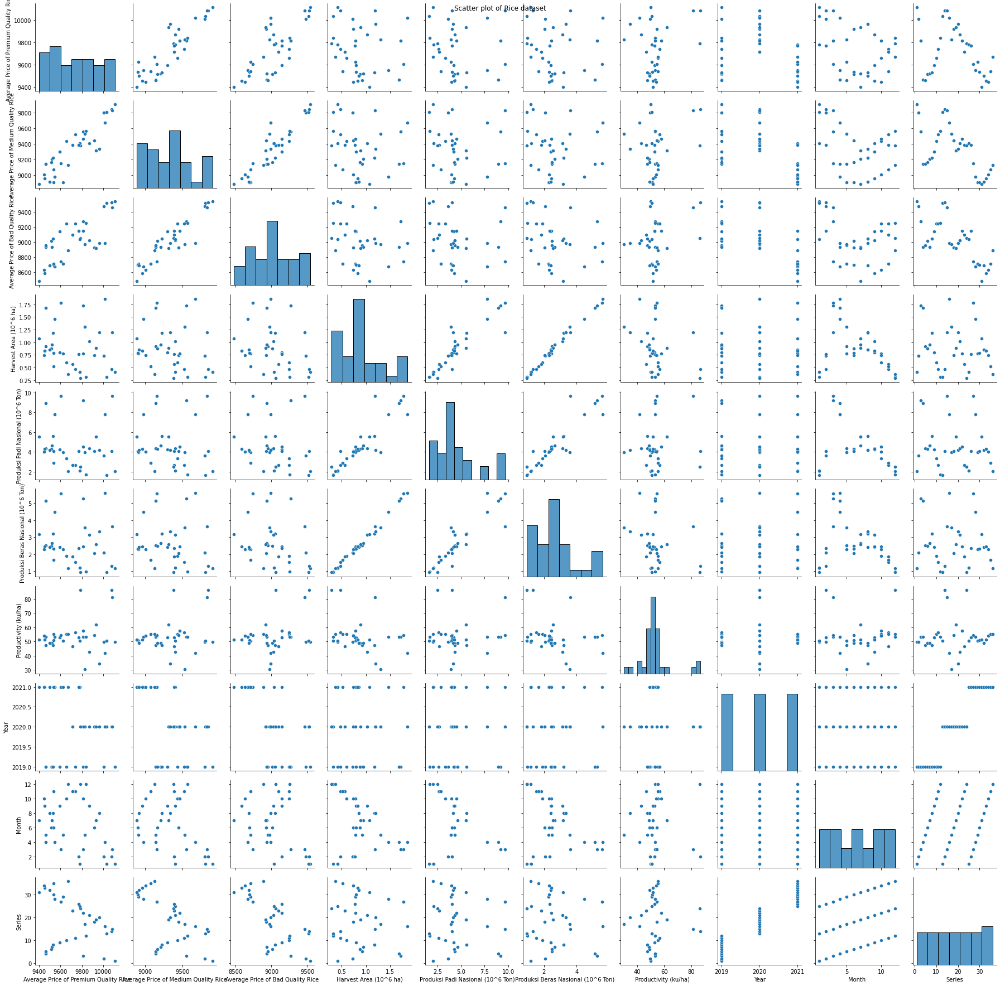

In [16]:
df_plot = df.copy()

g = sns.pairplot(df_plot)
g.fig.suptitle('Scatter plot of Rice dataset')
plt.tight_layout()
plt.show()

    From the results of the Scatter plots above, the following analysis results are obtained: 
    There are several features that have a linear relationship, 
    namely the relationship between Average Price of Premium Quality Rice, Average Price of Medium Quality Rice, and Average Price of Bad Quality Rice. 
    In addition, between harvest area, National Rice Production, and National Rice Production. 
    As well as between Series and month.

# 4. Feature Engineering

## Feature Scalling (Normalization)

In [17]:
from sklearn.preprocessing import MinMaxScaler

In [18]:
mmscalar_premium = MinMaxScaler()
df[['Average Price of Premium Quality Rice']] = mmscalar_premium.fit_transform(df[['Average Price of Premium Quality Rice']])

In [19]:
mmscalar_medium = MinMaxScaler()
df[['Average Price of Medium Quality Rice']] = mmscalar_medium.fit_transform(df[['Average Price of Medium Quality Rice']])

In [20]:
mmscalar_bad = MinMaxScaler()
df[['Average Price of Bad Quality Rice']] = mmscalar_bad.fit_transform(df[['Average Price of Bad Quality Rice']])

In [21]:
mmscalar_harvest = MinMaxScaler()
df[['Harvest Area (10^6 ha)']] = mmscalar_harvest.fit_transform(df[['Harvest Area (10^6 ha)']])

In [22]:
mmscalar_padi = MinMaxScaler()
df[['Produksi Padi Nasional (10^6 Ton)']] = mmscalar_padi.fit_transform(df[['Produksi Padi Nasional (10^6 Ton)']])

In [23]:
mmscalar_beras = MinMaxScaler()
df[['Produksi Beras Nasional (10^6 Ton)']] = mmscalar_beras.fit_transform(df[['Produksi Beras Nasional (10^6 Ton)']])

In [24]:
mmscalar_prod = MinMaxScaler()
df[['Productivity (ku/ha)']] = mmscalar_prod.fit_transform(df[['Productivity (ku/ha)']])

In [25]:
mmscalar_month = MinMaxScaler()
df[['Month']] = mmscalar_month.fit_transform(df[['Month']])

In [26]:
mmscalar_time = MinMaxScaler()
df[['Series']] = mmscalar_time.fit_transform(df[['Series']])

##  Correlation Matrix

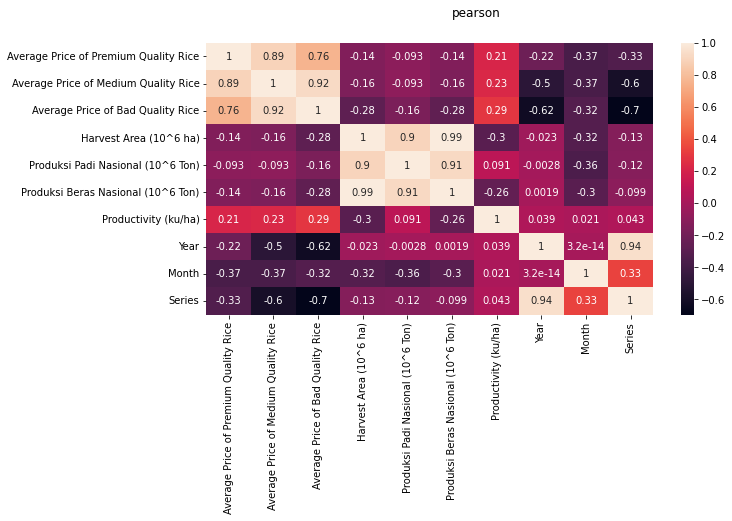

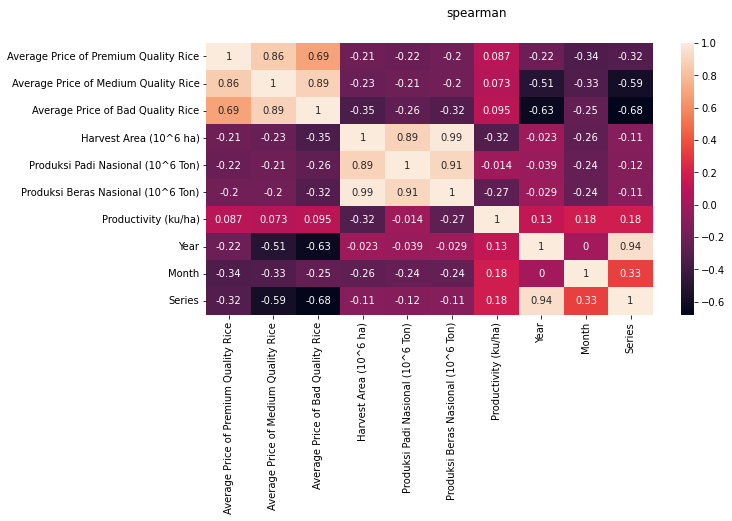

In [27]:
items = ['pearson', 'spearman']
for item in items:
    fig, axe = plt.subplots(figsize=(10,5))
    fig.suptitle(item)
    sns.heatmap(df.corr(method=item, numeric_only=True), annot=True)
    plt.show()


# 4.1 Correlation for Average Price of Premium Quality Rice

In [28]:
df.corr(method='pearson', numeric_only=True).sort_values('Average Price of Premium Quality Rice', ascending=False)['Average Price of Premium Quality Rice']

Average Price of Premium Quality Rice    1.000000
Average Price of Medium Quality Rice     0.892617
Average Price of Bad Quality Rice        0.757261
Productivity (ku/ha)                     0.212456
Produksi Padi Nasional (10^6 Ton)       -0.093068
Harvest Area (10^6 ha)                  -0.141796
Produksi Beras Nasional (10^6 Ton)      -0.144700
Year                                    -0.221887
Series                                  -0.331576
Month                                   -0.368033
Name: Average Price of Premium Quality Rice, dtype: float64

By using Pearson, It seems like Average Price of Medium Quality Rice, Average Price of Bad Quality Rice, and Productivity (ku/ha) have a positive correlation with Average Price of Premium Quality Rice

In [29]:
df.corr(method='spearman', numeric_only=True).sort_values('Average Price of Premium Quality Rice', ascending=False)['Average Price of Premium Quality Rice']

Average Price of Premium Quality Rice    1.000000
Average Price of Medium Quality Rice     0.861776
Average Price of Bad Quality Rice        0.690862
Productivity (ku/ha)                     0.087001
Produksi Beras Nasional (10^6 Ton)      -0.195392
Harvest Area (10^6 ha)                  -0.207403
Year                                    -0.216144
Produksi Padi Nasional (10^6 Ton)       -0.223424
Series                                  -0.315315
Month                                   -0.335401
Name: Average Price of Premium Quality Rice, dtype: float64

Using Spearman, the features correlated with the Average Price of Premium Quality Rice are similar

Text(0, 0.5, 'Average Price of Medium Quality Rice')

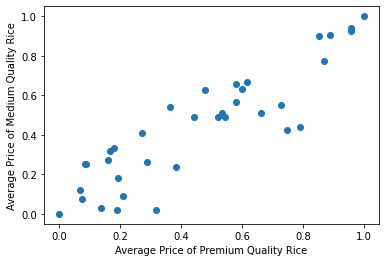

In [30]:
# Corelation between Average Price of Premium Quality Rice and Average Price of Medium Quality Rice 
plt.scatter(df['Average Price of Premium Quality Rice'], df['Average Price of Medium Quality Rice'])
plt.xlabel("Average Price of Premium Quality Rice")
plt.ylabel("Average Price of Medium Quality Rice")

Text(0, 0.5, 'Average Price of Bad Quality Rice')

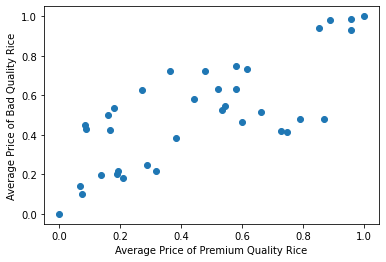

In [31]:
# Corelation between Average Price of Premium Quality Rice and Average Price of Bad Quality Rice 
plt.scatter(df['Average Price of Premium Quality Rice'], df['Average Price of Bad Quality Rice'])
plt.xlabel("Average Price of Premium Quality Rice")
plt.ylabel("Average Price of Bad Quality Rice")

Text(0, 0.5, 'Productivity (ku/ha)')

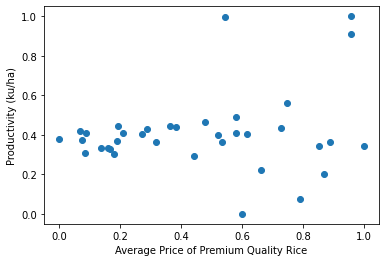

In [32]:
# Corelation between Average Price of Premium Quality Rice and Productivity (ku/ha)
plt.scatter(df['Average Price of Premium Quality Rice'], df['Productivity (ku/ha)'])
plt.xlabel("Average Price of Premium Quality Rice")
plt.ylabel("Productivity (ku/ha)")

# 4.2 Correlation for Average Price of Medium Quality Rice

In [33]:
df.corr(method='pearson', numeric_only=True).sort_values('Average Price of Medium Quality Rice', ascending=False)['Average Price of Medium Quality Rice']

Average Price of Medium Quality Rice     1.000000
Average Price of Bad Quality Rice        0.923962
Average Price of Premium Quality Rice    0.892617
Productivity (ku/ha)                     0.228019
Produksi Padi Nasional (10^6 Ton)       -0.092563
Produksi Beras Nasional (10^6 Ton)      -0.157504
Harvest Area (10^6 ha)                  -0.158175
Month                                   -0.367191
Year                                    -0.502006
Series                                  -0.595496
Name: Average Price of Medium Quality Rice, dtype: float64

By using Pearson, It seems like Average Price of Premium Quality Rice, Average Price of Bad Quality Rice, and Productivity (ku/ha) have a positive correlation with Average Price of Medium Quality Rice

In [34]:
df.corr(method='spearman', numeric_only=True).sort_values('Average Price of Medium Quality Rice', ascending=False)['Average Price of Medium Quality Rice']

Average Price of Medium Quality Rice     1.000000
Average Price of Bad Quality Rice        0.885714
Average Price of Premium Quality Rice    0.861776
Productivity (ku/ha)                     0.072844
Produksi Beras Nasional (10^6 Ton)      -0.199897
Produksi Padi Nasional (10^6 Ton)       -0.211706
Harvest Area (10^6 ha)                  -0.229804
Month                                   -0.326105
Year                                    -0.510885
Series                                  -0.590219
Name: Average Price of Medium Quality Rice, dtype: float64

By using spearman, most of the correlated features with Average Price of Medium Quality Rice Rice are similar

Text(0, 0.5, 'Average Price of Bad Quality Rice')

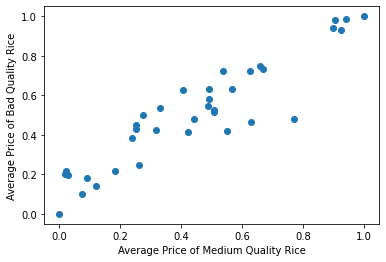

In [35]:
# Corelation between Average Price of Medium Quality Rice and Average Price of Bad Quality Rice 
plt.scatter(df['Average Price of Medium Quality Rice'], df['Average Price of Bad Quality Rice'])
plt.xlabel("Average Price of Medium Quality Rice")
plt.ylabel("Average Price of Bad Quality Rice")

Text(0, 0.5, 'Average Price of Premium Quality Rice')

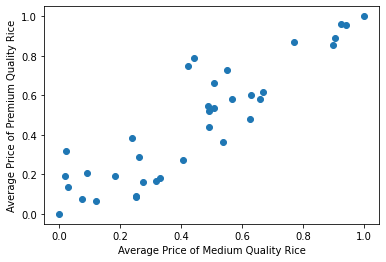

In [36]:
# Corelation between Average Price of Medium Quality Rice and Average Price of Premium Quality Rice 
plt.scatter(df['Average Price of Medium Quality Rice'], df['Average Price of Premium Quality Rice'])
plt.xlabel("Average Price of Medium Quality Rice")
plt.ylabel("Average Price of Premium Quality Rice")

Text(0, 0.5, 'Productivity (ku/ha)')

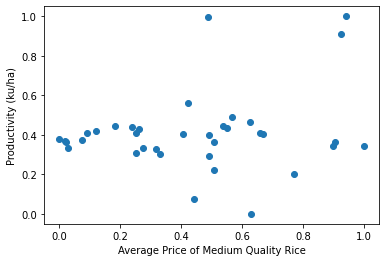

In [37]:
# Corelation between Average Price of Medium Quality Rice and Productivity (ku/ha)
plt.scatter(df['Average Price of Medium Quality Rice'], df['Productivity (ku/ha)'])
plt.xlabel("Average Price of Medium Quality Rice")
plt.ylabel("Productivity (ku/ha)")

# 4.3 Correlation for Average Price of Bad Quality Rice

In [38]:
df.corr(method='pearson', numeric_only=True).sort_values('Average Price of Bad Quality Rice', ascending=False)['Average Price of Bad Quality Rice']

Average Price of Bad Quality Rice        1.000000
Average Price of Medium Quality Rice     0.923962
Average Price of Premium Quality Rice    0.757261
Productivity (ku/ha)                     0.285900
Produksi Padi Nasional (10^6 Ton)       -0.164253
Produksi Beras Nasional (10^6 Ton)      -0.277309
Harvest Area (10^6 ha)                  -0.278471
Month                                   -0.323123
Year                                    -0.623711
Series                                  -0.695642
Name: Average Price of Bad Quality Rice, dtype: float64

By using Pearson, It seems like Average Price of Premium Quality Rice, Average Price of Medium Quality Rice, and Productivity (ku/ha) have a positive correlation with Average Price of Bad Quality Rice

In [39]:
df.corr(method='spearman', numeric_only=True).sort_values('Average Price of Bad Quality Rice', ascending=False)['Average Price of Bad Quality Rice']

Average Price of Bad Quality Rice        1.000000
Average Price of Medium Quality Rice     0.885714
Average Price of Premium Quality Rice    0.690862
Productivity (ku/ha)                     0.094981
Month                                   -0.248646
Produksi Padi Nasional (10^6 Ton)       -0.263988
Produksi Beras Nasional (10^6 Ton)      -0.315999
Harvest Area (10^6 ha)                  -0.346830
Year                                    -0.632057
Series                                  -0.678764
Name: Average Price of Bad Quality Rice, dtype: float64

By using spearman, most of the correlated features with Average Price of Bad Quality Rice Rice are similar

Text(0.5, 0, 'Average Price of Bad Quality Rice')

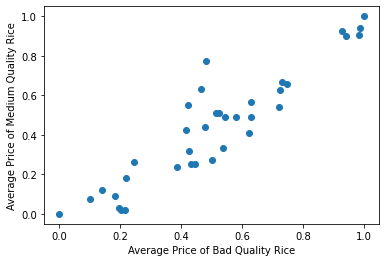

In [40]:
# Corelation between Average Price of Bad Quality Rice and Average Price of Medium Quality Rice 
plt.scatter(df['Average Price of Bad Quality Rice'], df['Average Price of Medium Quality Rice'])
plt.ylabel("Average Price of Medium Quality Rice")
plt.xlabel("Average Price of Bad Quality Rice")

Text(0, 0.5, 'Average Price of Premium Quality Rice')

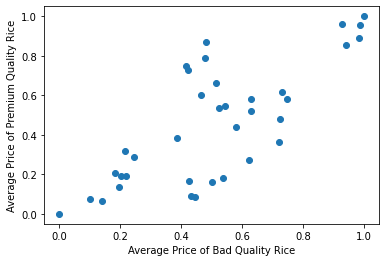

In [41]:
# Corelation between Average Price of Bad Quality Rice and Average Price of Premium Quality Rice 
plt.scatter(df['Average Price of Bad Quality Rice'], df['Average Price of Premium Quality Rice'])
plt.xlabel("Average Price of Bad Quality Rice")
plt.ylabel("Average Price of Premium Quality Rice")

Text(0, 0.5, 'Productivity (ku/ha)')

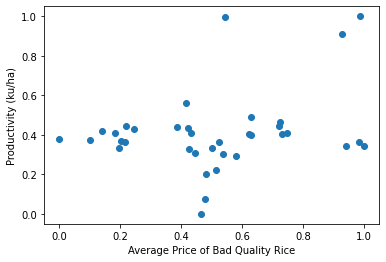

In [42]:
# Corelation between Average Price of Bad Quality Rice and Productivity (ku/ha)
plt.scatter(df['Average Price of Bad Quality Rice'], df["Productivity (ku/ha)"])
plt.xlabel("Average Price of Bad Quality Rice")
plt.ylabel("Productivity (ku/ha)")

# 5. Split dataset to train and test datasets
    df_train is rice data from 2019-2020
    df_test is rice data in 2021

In [43]:
df_train = df.iloc[:24,:]
df_test = df.iloc[24:,:]

In [44]:
# Training data
Series_train = df_train.loc[:, ['Series']]  # features
Monthly_train = df_train.loc[:, ['Month']]  # features
x_premium_train = df_train.loc[:, df_train.columns != 'Average Price of Premium Quality Rice'] # features
x_medium_train = df_train.loc[:, df_train.columns != 'Average Price of Medium Quality Rice'] # features
x_bad_train = df_train.loc[:, df_train.columns != 'Average Price of Bad Quality Rice'] # features
HargaBerasPremium_train = df_train.loc[:, 'Average Price of Premium Quality Rice']  # target
HargaBerasMedium_train = df_train.loc[:, 'Average Price of Medium Quality Rice']  # target
HargaBerasLuarkualitas_train = df_train.loc[:, 'Average Price of Bad Quality Rice'] # target

In [45]:
# Test Data
Series_test = df_test.loc[:, ['Series']]  # features
Monthly_test = df_test.loc[:, ['Month']]  # features
x_premium_test = df_test.loc[:, df_test.columns != 'Average Price of Premium Quality Rice'] # features
x_medium_test = df_test.loc[:, df_test.columns != 'Average Price of Medium Quality Rice'] # features
x_bad_test = df_test.loc[:, df_test.columns != 'Average Price of Bad Quality Rice'] # features
HargaBerasPremium_test = df_test.loc[:, 'Average Price of Premium Quality Rice']  # target
HargaBerasMedium_test = df_test.loc[:, 'Average Price of Medium Quality Rice']  # target
HargaBerasLuarkualitas_test = df_test.loc[:, 'Average Price of Bad Quality Rice'] # target

In [46]:
evaluation_train = {}
evaluation_test = {}

### SIMPLE LINEAR REGRESSION
### Average Price of Premium Quality Rice

In [47]:
# Train the model
model = LinearRegression()
model.fit(Series_train, HargaBerasPremium_train)

# Koefisien model
print ('Coefficients: ', model.coef_)
print ('Intercept: ',model.intercept_)
accuracy = model.score(Series_train, HargaBerasPremium_train)
print("Model Accuracy: ", accuracy)

Coefficients:  [0.41956154]
Intercept:  0.42951888968760743
Model Accuracy:  0.08337566624916459


Predicting on Train Data

In [48]:
AvgPricePremium_train = pd.Series(model.predict(Series_train), index=Series_train.index)

eval(evaluation_train,HargaBerasPremium_train,AvgPricePremium_train,'Train SLR Premium')

Predicting on Test Data

In [49]:
AvgPricePremium_pred = pd.Series(model.predict(Series_test), index=Series_test.index)

eval(evaluation_test,HargaBerasPremium_test,AvgPricePremium_pred,'Test SLR Premium')

### Multiple Linear Regression
### Average Price of Premium Quality Rice

In [50]:
regr = LinearRegression()
regr.fit(x_premium_train,HargaBerasPremium_train)

print('Coefficients: ', regr.coef_)
print ('Intercept: ',regr.intercept_)

accuracy = regr.score(x_premium_train,HargaBerasPremium_train)
print("Model Accuracy: ", accuracy)

Coefficients:  [ 1.33106668 -0.38872708  0.45522307  0.29690322 -0.77191604 -0.14921337
  0.15113937  0.01470651  0.05644126]
Intercept:  -305.1478370340474
Model Accuracy:  0.8997506898369665


Predicting on Train Data

In [51]:
AvgPricePremium_train_v2 = pd.Series(regr.predict(x_premium_train), index=x_premium_train.index)

eval(evaluation_train,HargaBerasPremium_train,AvgPricePremium_train_v2,'Train MLR Premium')

Predicting on Test Data

In [52]:
AvgPricePremium_pred_v2 = pd.Series(regr.predict(x_premium_test), index=x_premium_test.index)

eval(evaluation_test,HargaBerasPremium_test,AvgPricePremium_pred_v2,'Test MLR Premium')

explain the model's predictions using SHAP

Shapley on Train Data

In [53]:
explainer = shap.Explainer(regr, x_premium_train)
shap_values = explainer(x_premium_train)

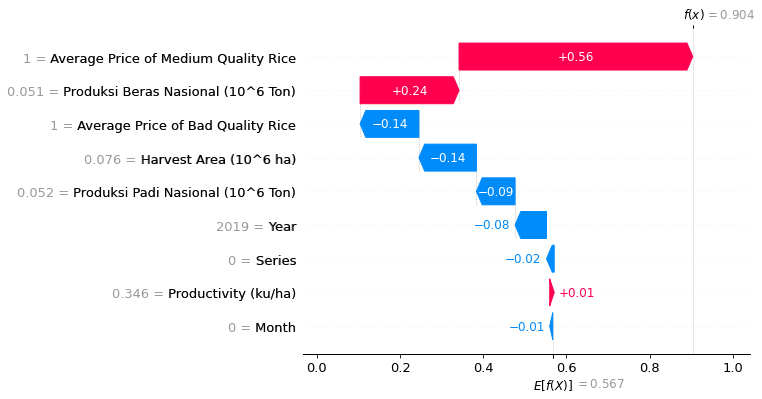

In [54]:
shap.plots.waterfall(shap_values[0])

In [55]:
shap_values = explainer.shap_values(x_premium_train)

In [56]:
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values, x_premium_train,link="logit")

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


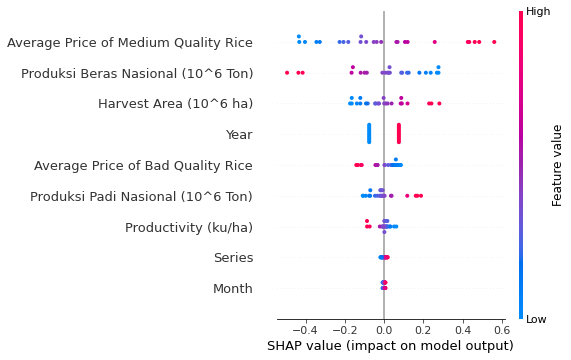

In [57]:
shap.summary_plot(shap_values, x_premium_train)

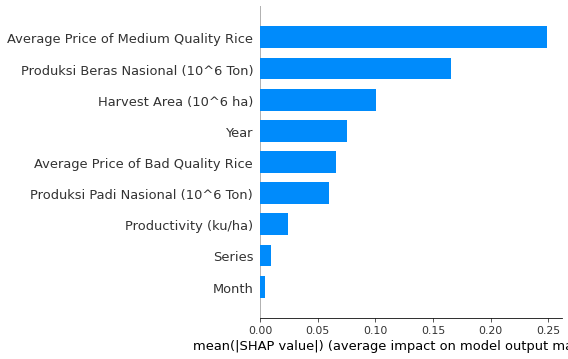

In [58]:
shap.summary_plot(shap_values, x_premium_train, plot_type ="bar")

    The feature important that has the largest average SHAP value in the Multiple Linear Regression method on Average Price of Premium Quality Rice is  Average Price of Medium Quality Rice. High values of the Average Price of Medium Quality Rice variable have a high positive contribution on the prediction, while low values have a high negative contribution.

Shapley on Test Data

In [59]:
explainer = shap.Explainer(regr, x_premium_test)
shap_values = explainer(x_premium_test)

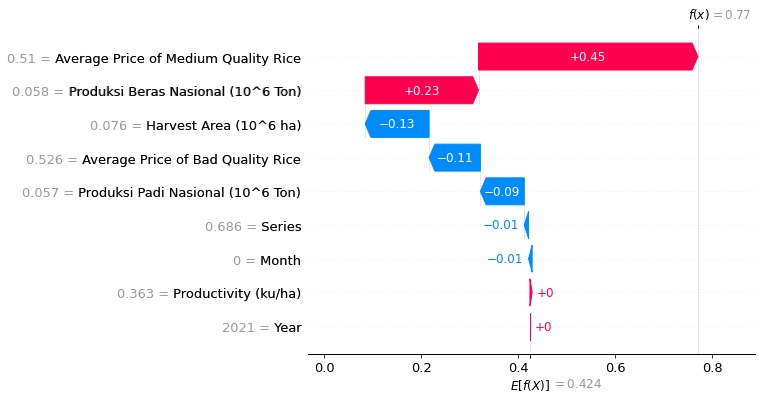

In [60]:
shap.plots.waterfall(shap_values[0])

In [61]:
shap_values = explainer.shap_values(x_premium_test)

In [62]:
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values, x_premium_test,link="logit")

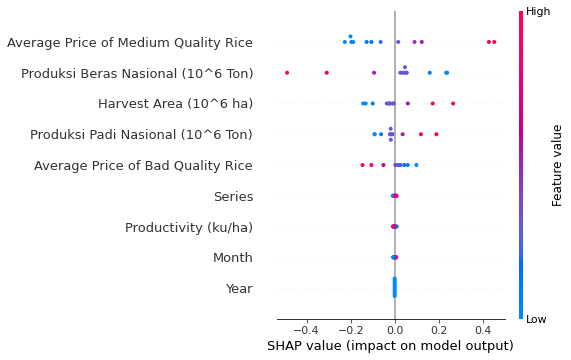

In [63]:
shap.summary_plot(shap_values, x_premium_test)

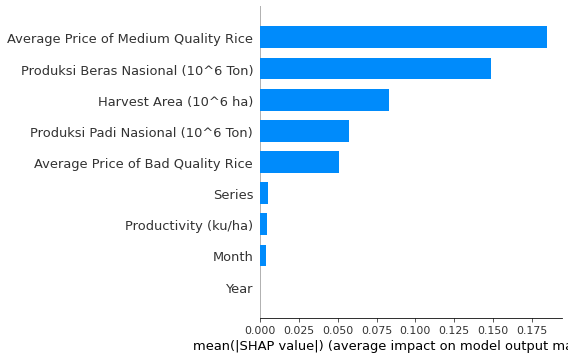

In [64]:
shap.summary_plot(shap_values, x_premium_test, plot_type ="bar")

    The feature important that has the largest average SHAP value in the Multiple Linear Regression method on Average Price of Premium Quality Rice is  Average Price of Medium Quality Rice. High values of the Average Price of Medium Quality Rice variable have a high positive contribution on the prediction, while low values have a high negative contribution.

## explain the model's predictions using Lime

In [65]:
# Create the Explainer
explainer = lime.lime_tabular.LimeTabularExplainer(x_premium_train.values, feature_names=x_premium_train.columns.values.tolist(),
                                                  class_names=['Average Price of Premium Quality Rice'], verbose=True, mode='regression')

In [66]:
# Choose the 5th instance and use it to predict the results
j = 5
exp = explainer.explain_instance(x_premium_test.values[j], regr.predict, num_features=len(x_premium_test.columns.values.tolist()))

Intercept -146.13898897323264
Prediction_local [-84.13544832]
Right: 0.25300333654558926


X does not have valid feature names, but LinearRegression was fitted with feature names


In [67]:
# Show the predictions
exp.show_in_notebook(show_table=True)

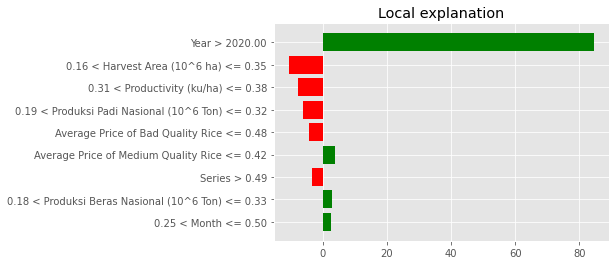

In [68]:
with plt.style.context("ggplot"):
    exp.as_pyplot_figure()

In [69]:
exp.as_list()

[('Year > 2020.00', 84.38845166039252),
 ('0.16 < Harvest Area (10^6 ha) <= 0.35', -10.43947238211341),
 ('0.31 < Productivity (ku/ha) <= 0.38', -7.791865094884013),
 ('0.19 < Produksi Padi Nasional (10^6 Ton) <= 0.32', -5.994023399030662),
 ('Average Price of Bad Quality Rice <= 0.48', -4.301311309702245),
 ('Average Price of Medium Quality Rice <= 0.42', 3.84601244947271),
 ('Series > 0.49', -3.4368362450576044),
 ('0.18 < Produksi Beras Nasional (10^6 Ton) <= 0.33', 3.053531882179126),
 ('0.25 < Month <= 0.50', 2.6790530881289025)]

## Random Forest
### Average Price of Premium Quality Rice

In [70]:
# Train the model
regressor = RandomForestRegressor(n_estimators = 1000, random_state=42)
regressor.fit(x_premium_train,HargaBerasPremium_train)

accuracy = regressor.score(x_premium_train,HargaBerasPremium_train)
print("Model Accuracy: ", accuracy)

Model Accuracy:  0.968454766906711


Predicting on Train Data

In [71]:
AvgPricePremium_train_with_randomforest = pd.Series(regressor.predict(x_premium_train), index=x_premium_train.index)

eval(evaluation_train,HargaBerasPremium_train,AvgPricePremium_train_with_randomforest,'Train RF Premium')

Predicting on Test Data

In [72]:
AvgPricePremium_pred_with_randomforest = pd.Series(regressor.predict(x_premium_test), index=x_premium_test.index)

eval(evaluation_test,HargaBerasPremium_test,AvgPricePremium_pred_with_randomforest,'Test RF Premium')

# explain the model's predictions using SHAP

In [73]:
explainer = shap.TreeExplainer(regressor)

Shap Explanation at Train Data

In [74]:
shap_values = explainer.shap_values(x_premium_train)

In [75]:
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values,x_premium_train,link="logit")

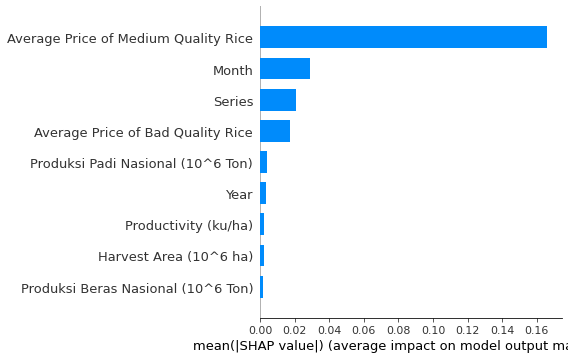

In [76]:
shap.summary_plot(shap_values, x_premium_train, plot_type="bar")

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


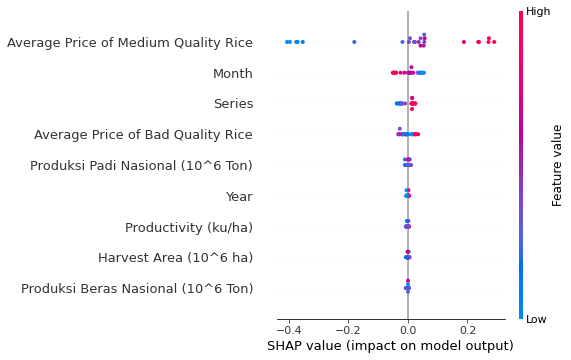

In [77]:
shap.summary_plot(shap_values, x_premium_train)

    The feature important that has the largest average SHAP value in the Random Forest Regression method on Average Price of Premium Quality Rice is  Average Price of Medium Quality Rice. High values of the Average Price of Medium Quality Rice variable have a high positive contribution on the prediction, while low values have a high negative contribution.

Shap Explanation at Test Data

In [78]:
shap_values = explainer.shap_values(x_premium_test)

In [79]:
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values,x_premium_test,link="logit")

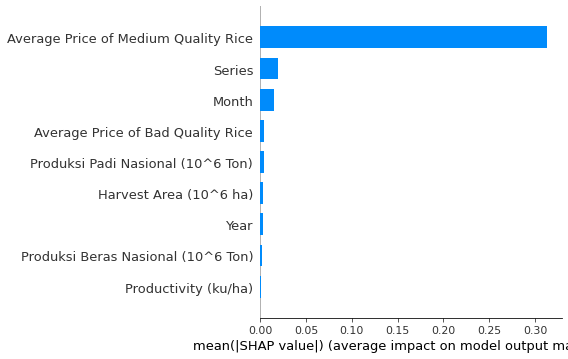

In [80]:
shap.summary_plot(shap_values, x_premium_test, plot_type="bar")

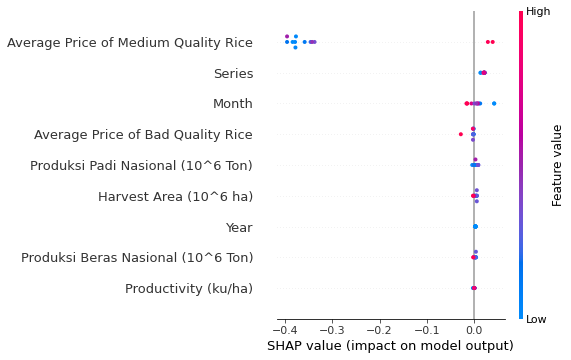

In [81]:
shap.summary_plot(shap_values, x_premium_test)

    The feature important that has the largest average SHAP value in the Random Forest method on Premium Quality Rice is Average Price of Medium Quality Rice. High values of the Average Price of Medium Quality Rice variable have a high positive contribution on the prediction, while low values have a high negative contribution.

### explain the model's predictions using Lime

In [82]:
# Create the Explainer
explainer = lime.lime_tabular.LimeTabularExplainer(x_premium_train.values, feature_names=x_premium_train.columns.values.tolist(),
                                                  class_names=['Average Price of Premium Quality Rice'], verbose=True, mode='regression')

In [83]:
# Choose the 5th instance and use it to predict the results
j = 5
exp = explainer.explain_instance(x_premium_test.values[j], regressor.predict, num_features=len(x_premium_test.columns.values.tolist()))

X does not have valid feature names, but RandomForestRegressor was fitted with feature names


Intercept 0.6594608435400535
Prediction_local [0.25365031]
Right: 0.23451961323241546


In [84]:
# Show the predictions
exp.show_in_notebook(show_table=True)

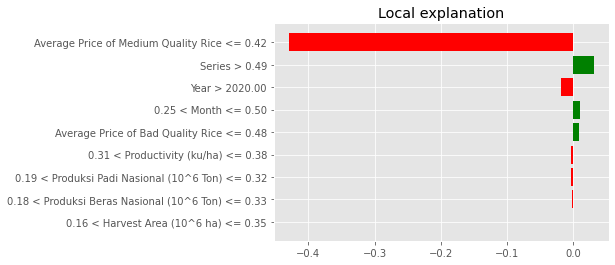

In [85]:
with plt.style.context("ggplot"):
    exp.as_pyplot_figure()

In [86]:
exp.as_list()

[('Average Price of Medium Quality Rice <= 0.42', -0.4288818312146927),
 ('Series > 0.49', 0.03060974803035551),
 ('Year > 2020.00', -0.019130698507284154),
 ('0.25 < Month <= 0.50', 0.009504829597098606),
 ('Average Price of Bad Quality Rice <= 0.48', 0.009322399244578113),
 ('0.31 < Productivity (ku/ha) <= 0.38', -0.002919739005359309),
 ('0.19 < Produksi Padi Nasional (10^6 Ton) <= 0.32', -0.002802723400273011),
 ('0.18 < Produksi Beras Nasional (10^6 Ton) <= 0.33', -0.001270158678725437),
 ('0.16 < Harvest Area (10^6 ha) <= 0.35', -0.00024235786605121434)]

### SIMPLE LINEAR REGRESSION
### Average Price of Medium Quality Rice

In [87]:
# Train the model
model2 = LinearRegression()
model2.fit(Series_train, HargaBerasMedium_train)

# Koefisien model
print ('Coefficients: ', model2.coef_)
print ('Intercept: ',model2.intercept_)

Coefficients:  [-0.03151566]
Intercept:  0.5882390543884172


Predicting on Train Data

In [88]:
AvgPriceMedium_train = pd.Series(model2.predict(Series_train), index=Series_train.index)

eval(evaluation_train,HargaBerasMedium_train,AvgPriceMedium_train,'Train SLR Medium')

Predicting on Test Data

In [89]:
AvgPriceMedium_pred = pd.Series(model2.predict(Series_test), index=Series_test.index)

eval(evaluation_test,HargaBerasMedium_test,AvgPriceMedium_pred,'Test SLR Medium')

### Multiple Linear Regression
### Average Price of Medium Quality Rice

In [90]:
regr_v2 = LinearRegression()
regr_v2.fit(x_medium_train, HargaBerasMedium_train)

print('Coefficients: ', regr_v2.coef_)
print ('Intercept: ',regr_v2.intercept_)

accuracy = regr_v2.score(x_medium_train,HargaBerasMedium_train)
print("Model Accuracy: ", accuracy)

Coefficients:  [ 0.4302224   0.61763649 -0.16939179 -0.31255941  0.5200206   0.11075759
 -0.00596404 -0.04604263 -0.01651535]
Intercept:  11.958840958438154
Model Accuracy:  0.9475140265566705


Predicting on Train Data

In [91]:
AvgPriceMedium_train_v2 = pd.Series(regr_v2.predict(x_medium_train), index=x_medium_train.index)

eval(evaluation_train,HargaBerasMedium_train,AvgPriceMedium_train_v2,'Train MLR Medium')

Predicting on Test Data

In [92]:
AvgPriceMedium_pred_v2 = pd.Series(regr_v2.predict(x_medium_test), index=x_medium_test.index)

eval(evaluation_test,HargaBerasMedium_test,AvgPriceMedium_pred_v2,'Test MLR Medium')

explain the model's predictions using SHAP

Shapley on Train Data

In [93]:
explainer = shap.LinearExplainer(regr_v2, x_medium_train)
shap_values = explainer(x_medium_train)

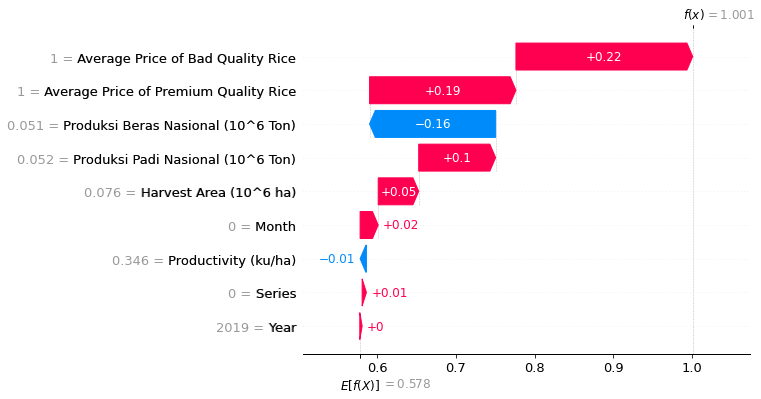

In [94]:
shap.plots.waterfall(shap_values[0])

In [95]:
shap_values_v2 = explainer.shap_values(x_medium_train)

In [96]:
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values_v2, x_medium_train,link="logit")

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


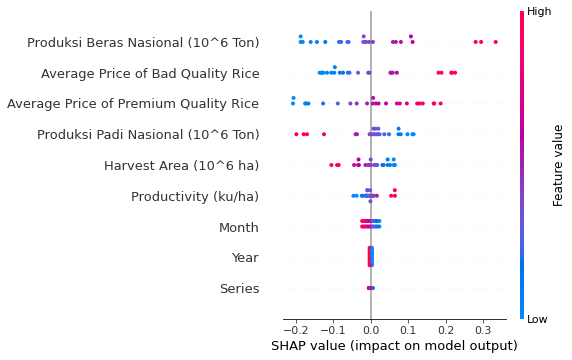

In [97]:
shap.summary_plot(shap_values_v2, x_medium_train)

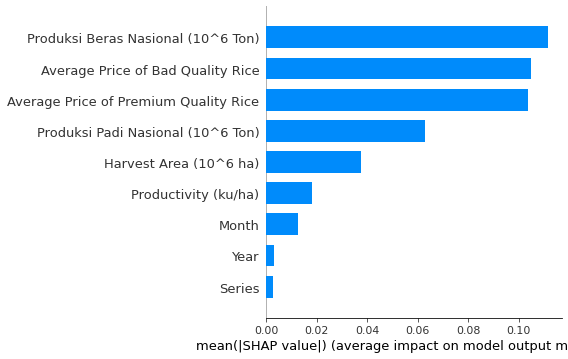

In [98]:
shap.summary_plot(shap_values_v2, x_medium_test, plot_type ="bar")

    The feature important that has the largest average SHAP value in the Multiple Linear Regression method on Average Price of Medium Quality Rice is  Produksi Beras Nasional. High values of the Produksi Beras Nasional variable have a high positive contribution on the prediction, while low values have a high negative contribution.

Shapley on Test Data

In [99]:
explainer_v2 = shap.LinearExplainer(regr_v2, x_medium_test)
shap_values_v2 = explainer_v2(x_medium_test)

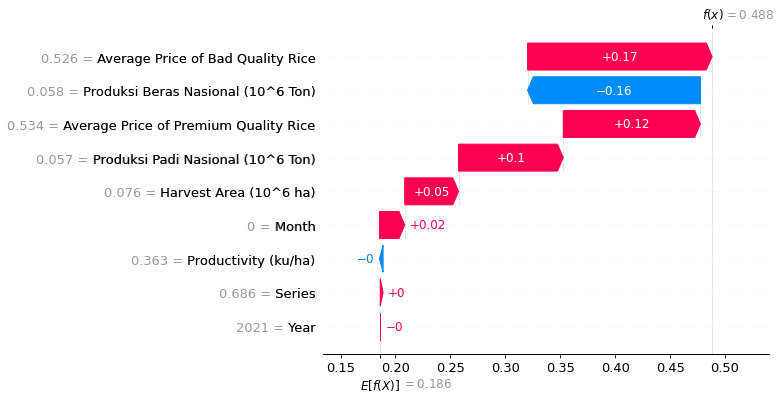

In [100]:
shap.plots.waterfall(shap_values_v2[0])

In [101]:
shap_values_v2 = explainer_v2.shap_values(x_medium_test)

In [102]:
shap.initjs()
shap.force_plot(explainer_v2.expected_value, shap_values_v2, x_medium_test,link="logit")

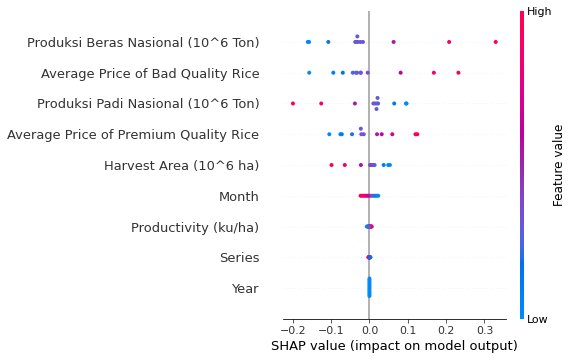

In [103]:
shap.summary_plot(shap_values_v2, x_medium_test)

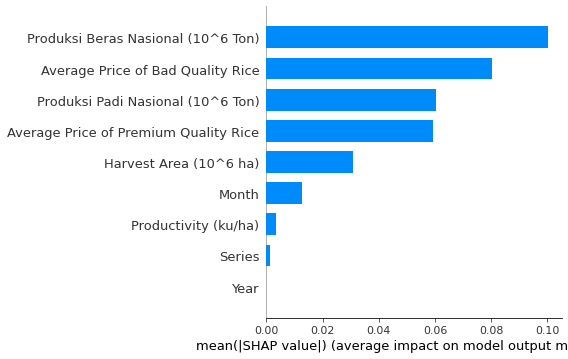

In [104]:
shap.summary_plot(shap_values_v2, x_medium_test, plot_type ="bar")

    The feature important that has the largest average SHAP value in the Multiple Linear Regression method on Average Price of Medium Quality Rice is  Produksi Beras Nasional. High values of the Produksi Beras Nasional variable have a high positive contribution on the prediction, while low values have a high negative contribution.

## explain the model's predictions using Lime

In [105]:
# Create the Explainer
explainer = lime.lime_tabular.LimeTabularExplainer(x_medium_train.values, feature_names=x_medium_train.columns.values.tolist(),
                                                  class_names=['Average Price of Medium Quality Rice'], verbose=True, mode='regression')

In [106]:
# Choose the 5th instance and use it to predict the results
j = 5
exp = explainer.explain_instance(x_medium_test.values[j], regr_v2.predict, num_features=len(x_medium_test.columns.values.tolist()))

Intercept 6.799874899663123
Prediction_local [3.25638617]
Right: 0.12716821058354455


X does not have valid feature names, but LinearRegression was fitted with feature names


In [107]:
# Show the predictions
exp.show_in_notebook(show_table=True)

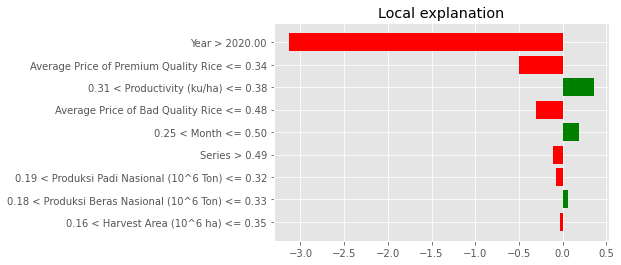

In [108]:
with plt.style.context("ggplot"):
    exp.as_pyplot_figure()

In [109]:
exp.as_list()

[('Year > 2020.00', -3.1292179630349506),
 ('Average Price of Premium Quality Rice <= 0.34', -0.4957976929101959),
 ('0.31 < Productivity (ku/ha) <= 0.38', 0.35338872995318305),
 ('Average Price of Bad Quality Rice <= 0.48', -0.30192064564762183),
 ('0.25 < Month <= 0.50', 0.18630670197318883),
 ('Series > 0.49', -0.11380395456961499),
 ('0.19 < Produksi Padi Nasional (10^6 Ton) <= 0.32', -0.0770138848943078),
 ('0.18 < Produksi Beras Nasional (10^6 Ton) <= 0.33', 0.061940048150833496),
 ('0.16 < Harvest Area (10^6 ha) <= 0.35', -0.02737006506515418)]

## Random Forest
### Average Price of Medium Quality Rice

In [110]:
# Train the model
regressor2 = RandomForestRegressor(n_estimators = 1000, random_state=42)
regressor2.fit(x_medium_train, HargaBerasMedium_train)

accuracy = regressor2.score(x_medium_train, HargaBerasMedium_train)
print("Model Accuracy: ", accuracy)

Model Accuracy:  0.9856807480673933


Predicting on Train Data

In [111]:
AvgPriceMedium_train_with_randomforest = pd.Series(regressor2.predict(x_medium_train), index=x_medium_train.index)

eval(evaluation_train,HargaBerasMedium_train,AvgPriceMedium_train_with_randomforest,'Train RF Medium')

Predicting on Test Data

In [112]:
AvgPriceMedium_pred_with_randomforest = pd.Series(regressor2.predict(x_medium_test), index=x_medium_test.index)

eval(evaluation_test,HargaBerasMedium_test,AvgPriceMedium_pred_with_randomforest,'Test RF Medium')

Explain the model's predictions using SHAP

In [113]:
explainer = shap.TreeExplainer(regressor2)

Shapley on Train Data

In [114]:
shap_values = explainer.shap_values(x_medium_train)

In [115]:
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values, x_medium_train,link="logit")

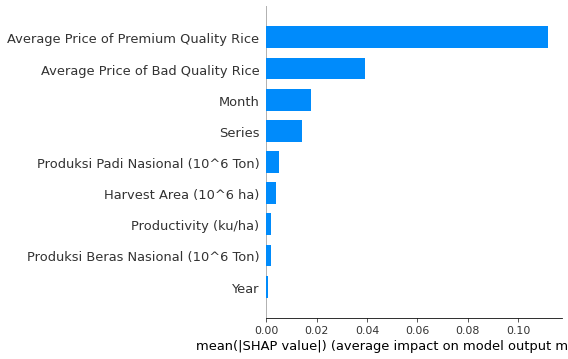

In [116]:
shap.summary_plot(shap_values, x_medium_train, plot_type="bar")

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


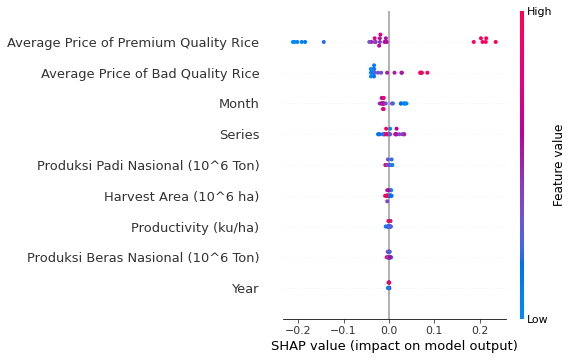

In [117]:
shap.summary_plot(shap_values, x_medium_train)

    The feature important that has the largest average SHAP value in the Random Forest Regression method on Average Price of Medium Quality Rice is  Average Price of Premium Quality Rice. High values of the Average Price of Premium Quality Rice variable have a high positive contribution on the prediction, while low values have a high negative contribution.

Shapley on Test Data

In [118]:
shap_values = explainer.shap_values(x_medium_test)

In [119]:
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values, x_medium_test,link="logit")

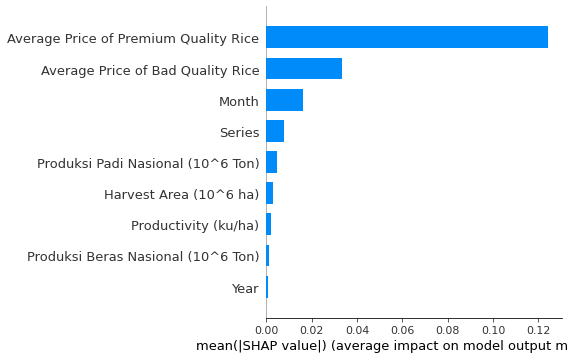

In [120]:
shap.summary_plot(shap_values, x_medium_test, plot_type="bar")

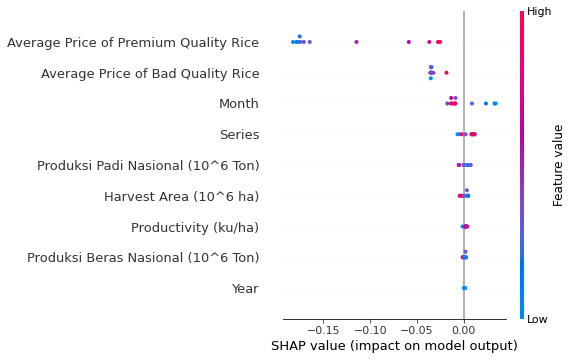

In [121]:
shap.summary_plot(shap_values, x_medium_test)

    The feature important that has the largest average SHAP value in the Random Forest Regression method on Average Price of Medium Quality Rice is  Average Price of Premium Quality Rice. 

## explain the model's predictions using Lime

In [122]:
# Create the Explainer
explainer = lime.lime_tabular.LimeTabularExplainer(x_medium_train.values, feature_names=x_medium_train.columns.values.tolist(),
                                                  class_names=['Average Price of Medium Quality Rice'], verbose=True, mode='regression')

In [123]:
# Choose the 5th instance and use it to predict the results
j = 5
exp = explainer.explain_instance(x_medium_test.values[j], regressor2.predict, num_features=len(x_medium_test.columns.values.tolist()))

X does not have valid feature names, but RandomForestRegressor was fitted with feature names


Intercept 0.6450146273772576
Prediction_local [0.37646536]
Right: 0.37644074504321606


In [124]:
# Show the predictions
exp.show_in_notebook(show_table=True)

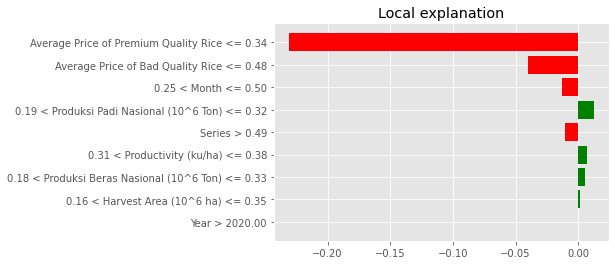

In [125]:
with plt.style.context("ggplot"):
    exp.as_pyplot_figure()

In [126]:
exp.as_list()

[('Average Price of Premium Quality Rice <= 0.34', -0.2305852294559939),
 ('Average Price of Bad Quality Rice <= 0.48', -0.04018831585106572),
 ('0.25 < Month <= 0.50', -0.012742635364353041),
 ('0.19 < Produksi Padi Nasional (10^6 Ton) <= 0.32', 0.012236540947094598),
 ('Series > 0.49', -0.010815312872732975),
 ('0.31 < Productivity (ku/ha) <= 0.38', 0.006944352198761079),
 ('0.18 < Produksi Beras Nasional (10^6 Ton) <= 0.33', 0.005392927256804281),
 ('0.16 < Harvest Area (10^6 ha) <= 0.35', 0.0012330274700780308),
 ('Year > 2020.00', -2.4618331317628013e-05)]

### SIMPLE LINEAR REGRESSION
### Average Price of Bad Quality Rice

In [127]:
# Train the model
model3 = LinearRegression()
model3.fit(Series_train, HargaBerasLuarkualitas_train)

# Koefisien model
print ('Coefficients: ', model3.coef_)
print ('Intercept: ',model3.intercept_)

accuracy = model3.score(Series_train,HargaBerasLuarkualitas_train)
print("Model Accuracy: ", accuracy)

Coefficients:  [-0.29113015]
Intercept:  0.7318282505585215
Model Accuracy:  0.08475109763276922


Predicting on Train Data

In [128]:
AvgPriceBad_train = pd.Series(model3.predict(Series_train), index=Series_train.index)

eval(evaluation_train,HargaBerasLuarkualitas_train,AvgPriceBad_train,'Train SLR Bad')

Predicting on Test Data

In [129]:
AvgPriceBad_pred = pd.Series(model3.predict(Series_test), index=Series_test.index)

eval(evaluation_test,HargaBerasLuarkualitas_test,AvgPriceBad_pred,'Test SLR Bad')

### Multiple Linear Regression
### Average Price of Bad Quality Rice

In [130]:
regr_v3 = LinearRegression()
regr_v3.fit(x_bad_train,HargaBerasLuarkualitas_train)

print('Coefficients: ', regr_v3.coef_)
print ('Intercept: ',regr_v3.intercept_)

accuracy = regr_v3.score(x_bad_train,HargaBerasLuarkualitas_train)
print("Model Accuracy: ", accuracy)

Coefficients:  [-0.1669102   0.82049854 -0.85239129  0.33528767  0.34457138 -0.08696782
 -0.05698536 -0.06403962 -0.03966457]
Intercept:  115.49793004482214
Model Accuracy:  0.9091254084835306


Predicting on Train Data

In [131]:
AvgPriceBad_train_v2 = pd.Series(regr_v3.predict(x_bad_train), index=x_bad_train.index)

eval(evaluation_train,HargaBerasLuarkualitas_train,AvgPriceBad_train_v2,'Train MLR Bad')

Predicting on Test Data

In [132]:
AvgPriceBad_pred_v2 = pd.Series(regr_v3.predict(x_bad_test), index=x_bad_test.index)

eval(evaluation_test,HargaBerasLuarkualitas_test,AvgPriceBad_pred_v2,'Test MLR Bad')

Explain the model's predictions using SHAP

Shapley on Train Data

In [133]:
explainer = shap.LinearExplainer(regr_v3, x_bad_train)
shap_values = explainer(x_bad_train)

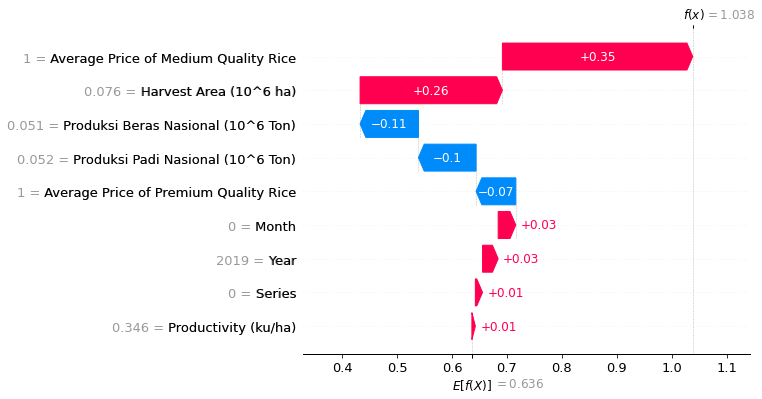

In [134]:
shap.plots.waterfall(shap_values[0])

In [135]:
shap_values = explainer.shap_values(x_bad_train)

In [136]:
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values, x_bad_train,link="logit")

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


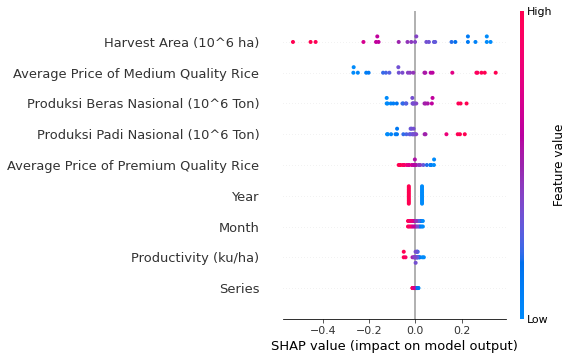

In [137]:
shap.summary_plot(shap_values, x_bad_train)

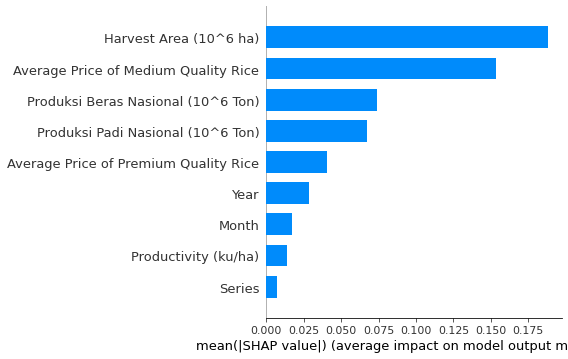

In [138]:
shap.summary_plot(shap_values, x_bad_train, plot_type ="bar")

    The feature important that has the largest average SHAP value in the Multiple Linear Regression method on Average Price of Bad Quality Rice is Harvest Area. High values of the Harvest Area variable have a high negative contribution on the prediction, while low values have a high positive contribution.

Shapley on Test Data

In [139]:
explainer_v3 = shap.LinearExplainer(regr_v3, x_bad_test)
shap_values_v3 = explainer_v3(x_bad_test)

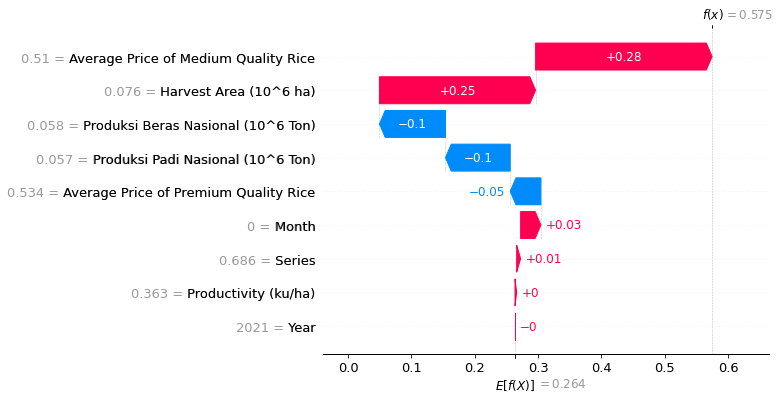

In [140]:
shap.plots.waterfall(shap_values_v3[0])

In [141]:
shap_values_v3 = explainer_v3.shap_values(x_bad_test)

In [142]:
shap.initjs()
shap.force_plot(explainer_v3.expected_value, shap_values_v3, x_bad_test,link="logit")

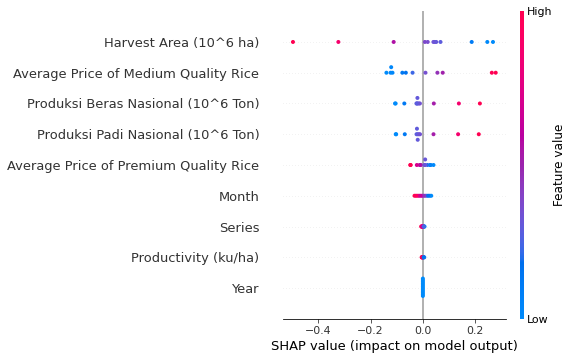

In [143]:
shap.summary_plot(shap_values_v3, x_bad_test)

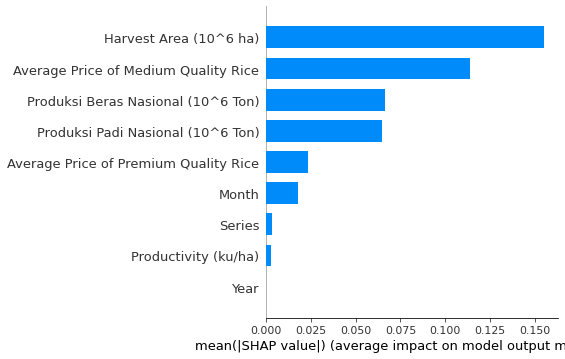

In [144]:
shap.summary_plot(shap_values_v3, x_bad_test, plot_type ="bar")

    The feature important that has the largest average SHAP value in the Multiple Linear Regression method on Average Price of Bad Quality Rice is Harvest Area. High values of the Harvest Area variable have a high negative contribution on the prediction, while low values have a high positive contribution.

### explain the model's predictions using Lime

In [145]:
# Create the Explainer
explainer = lime.lime_tabular.LimeTabularExplainer(x_bad_train.values, feature_names=x_bad_train.columns.values.tolist(),
                                                  class_names=['Average Price of Bad Quality Rice'], verbose=True, mode='regression')

In [146]:
# Choose the 5th instance and use it to predict the results
j = 5
exp = explainer.explain_instance(x_bad_test.values[j], regr_v3.predict, num_features=len(x_bad_test.columns.values.tolist()))

Intercept 57.19111092696621
Prediction_local [29.95744628]
Right: 0.15302217340196478


X does not have valid feature names, but LinearRegression was fitted with feature names


In [147]:
# Show the predictions
exp.show_in_notebook(show_table=True)

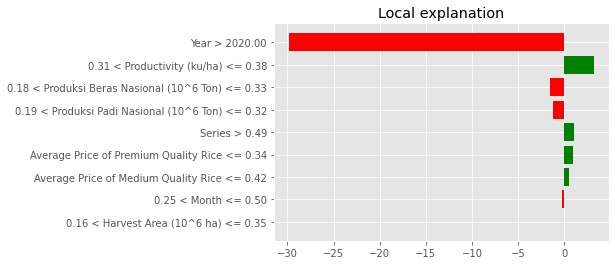

In [148]:
with plt.style.context("ggplot"):
    exp.as_pyplot_figure()

In [149]:
exp.as_list()

[('Year > 2020.00', -29.804424110171208),
 ('0.31 < Productivity (ku/ha) <= 0.38', 3.1542102331237563),
 ('0.18 < Produksi Beras Nasional (10^6 Ton) <= 0.33', -1.5782791815199053),
 ('0.19 < Produksi Padi Nasional (10^6 Ton) <= 0.32', -1.2371470788522432),
 ('Series > 0.49', 1.0178923125187727),
 ('Average Price of Premium Quality Rice <= 0.34', 0.9827167853524018),
 ('Average Price of Medium Quality Rice <= 0.42', 0.520951026661113),
 ('0.25 < Month <= 0.50', -0.24609558253449934),
 ('0.16 < Harvest Area (10^6 ha) <= 0.35', -0.043489047971205314)]

## Random Forest
### Average Price of Bad Quality Rice

In [150]:
# Train the model
regressor3 = RandomForestRegressor(n_estimators = 1000, random_state=42)
regressor3.fit(x_bad_train, HargaBerasLuarkualitas_train)

accuracy = regressor3.score(x_bad_train, HargaBerasLuarkualitas_train)
print("Model Accuracy: ", accuracy)

Model Accuracy:  0.9701488947908247


Predicting on Train Data

In [151]:
AvgPriceBad_train_with_randomforest = pd.Series(regressor3.predict(x_bad_train), index=x_bad_train.index)

eval(evaluation_train,HargaBerasLuarkualitas_train,AvgPriceBad_train_with_randomforest,'Train RF Bad')

Predicting on Test Data

In [152]:
AvgPriceBad_pred_with_randomforest = pd.Series(regressor3.predict(x_bad_test), index=x_bad_test.index)

eval(evaluation_test,HargaBerasLuarkualitas_test,AvgPriceBad_pred_with_randomforest,'Test RF Bad')

Explain the model's predictions using SHAP

In [153]:
explainer = shap.TreeExplainer(regressor3)

Shapley on Train Data

In [154]:
shap_values = explainer.shap_values(x_bad_train)

In [155]:
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values, x_bad_train,link="logit")

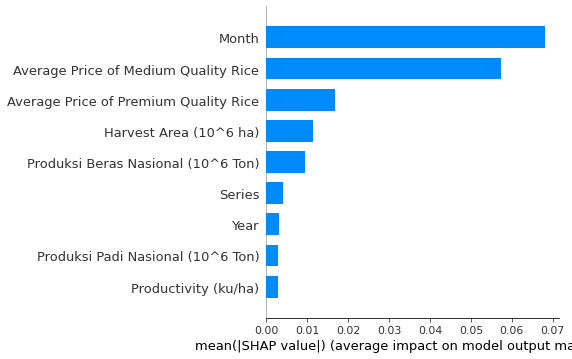

In [156]:
shap.summary_plot(shap_values, x_bad_train, plot_type="bar")

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


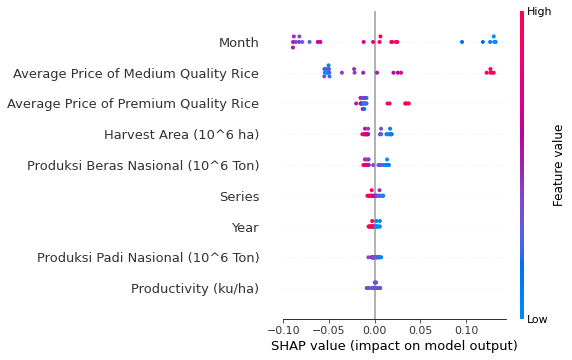

In [157]:
shap.summary_plot(shap_values, x_bad_train)

    The feature important that has the largest average SHAP value in the Random Forest Regression method on Average Price of Bad Quality Rice is Month. 

Shapley on Test Data

In [158]:
shap_values = explainer.shap_values(x_bad_test)

In [159]:
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values, x_bad_test,link="logit")

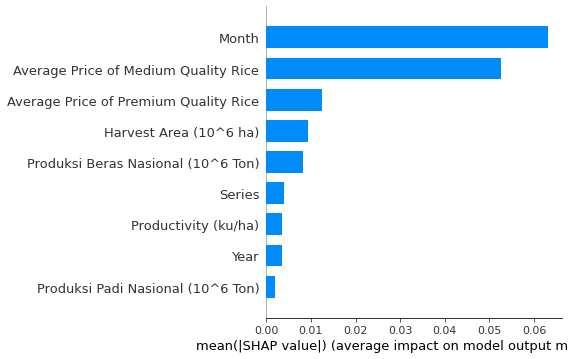

In [160]:
shap.summary_plot(shap_values, x_bad_test, plot_type="bar")

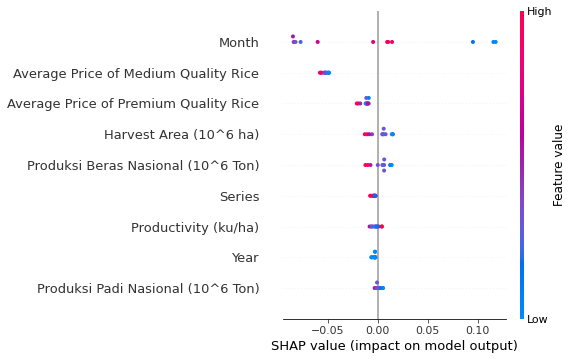

In [161]:
shap.summary_plot(shap_values, x_bad_test)

    The feature important that has the largest average SHAP value in the Random Forest Regression method on Average Price of Bad Quality Rice is Month. 

### explain the model's predictions using Lime

In [162]:
# Create the Explainer
explainer = lime.lime_tabular.LimeTabularExplainer(x_bad_train.values, feature_names=x_bad_train.columns.values.tolist(),
                                                  class_names=['Average Price of Bad Quality Rice'], verbose=True, mode='regression')

In [163]:
# Choose the 5th instance and use it to predict the results
j = 5
exp = explainer.explain_instance(x_bad_test.values[j], regressor3.predict, num_features=len(x_bad_test.columns.values.tolist()))

X does not have valid feature names, but RandomForestRegressor was fitted with feature names


Intercept 0.670482968666127
Prediction_local [0.49571936]
Right: 0.4878007621792281


In [164]:
# Show the predictions
exp.show_in_notebook(show_table=True)

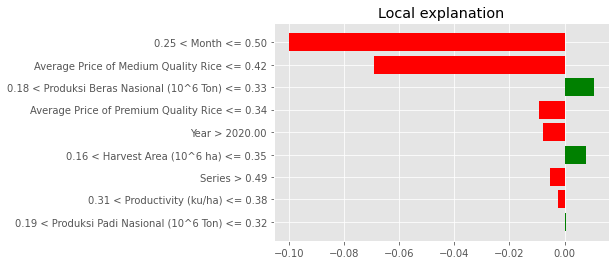

In [165]:
with plt.style.context("ggplot"):
    exp.as_pyplot_figure()

In [166]:
exp.as_list()

[('0.25 < Month <= 0.50', -0.09990205913511527),
 ('Average Price of Medium Quality Rice <= 0.42', -0.06906860543304828),
 ('0.18 < Produksi Beras Nasional (10^6 Ton) <= 0.33', 0.010519514306452706),
 ('Average Price of Premium Quality Rice <= 0.34', -0.009162769836714867),
 ('Year > 2020.00', -0.007918594353254324),
 ('0.16 < Harvest Area (10^6 ha) <= 0.35', 0.007699963311191721),
 ('Series > 0.49', -0.0051456656665156576),
 ('0.31 < Productivity (ku/ha) <= 0.38', -0.0022354482649839203),
 ('0.19 < Produksi Padi Nasional (10^6 Ton) <= 0.32', 0.0004500529383436325)]

Returns the MinMaxScaler value to get the actual data 

In [167]:
df[['Average Price of Premium Quality Rice']] = mmscalar_premium.inverse_transform(df[['Average Price of Premium Quality Rice']])

In [168]:
df[['Average Price of Medium Quality Rice']] = mmscalar_medium.inverse_transform(df[['Average Price of Medium Quality Rice']])

In [169]:
df[['Average Price of Bad Quality Rice']] = mmscalar_bad.inverse_transform(df[['Average Price of Bad Quality Rice']])

Premium Rice

In [170]:
HargaBerasPremium_test = HargaBerasPremium_test.to_numpy()
HargaBerasPremium_test = np.reshape(HargaBerasPremium_test, (-1,1)) 
HargaBerasPremium_test = mmscalar_premium.inverse_transform(HargaBerasPremium_test)
HargaBerasPremium_test = np.reshape(HargaBerasPremium_test, (12,))
HargaBerasPremium_test = pd.Series(HargaBerasPremium_test, index=x_premium_test.index)

In [171]:
AvgPricePremium_pred = AvgPricePremium_pred.to_numpy()
AvgPricePremium_pred = np.reshape(AvgPricePremium_pred, (-1,1)) 
AvgPricePremium_pred = mmscalar_premium.inverse_transform(AvgPricePremium_pred)
AvgPricePremium_pred = np.reshape(AvgPricePremium_pred, (12,))
AvgPricePremium_pred = pd.Series(AvgPricePremium_pred, index=x_premium_test.index)

In [172]:
AvgPricePremium_pred_v2 = AvgPricePremium_pred_v2.to_numpy()
AvgPricePremium_pred_v2 = np.reshape(AvgPricePremium_pred_v2, (-1,1)) 
AvgPricePremium_pred_v2 = mmscalar_premium.inverse_transform(AvgPricePremium_pred_v2)
AvgPricePremium_pred_v2 = np.reshape(AvgPricePremium_pred_v2, (12,))
AvgPricePremium_pred_v2 = pd.Series(AvgPricePremium_pred_v2, index=x_premium_test.index)

In [173]:
AvgPricePremium_pred_with_randomforest = AvgPricePremium_pred_with_randomforest.to_numpy()
AvgPricePremium_pred_with_randomforest = np.reshape(AvgPricePremium_pred_with_randomforest, (-1,1)) 
AvgPricePremium_pred_with_randomforest = mmscalar_premium.inverse_transform(AvgPricePremium_pred_with_randomforest)
AvgPricePremium_pred_with_randomforest = np.reshape(AvgPricePremium_pred_with_randomforest, (12,))
AvgPricePremium_pred_with_randomforest = pd.Series(AvgPricePremium_pred_with_randomforest, index=x_premium_test.index)

Medium

In [174]:
HargaBerasMedium_test = HargaBerasMedium_test.to_numpy()
HargaBerasMedium_test = np.reshape(HargaBerasMedium_test, (-1,1)) 
HargaBerasMedium_test = mmscalar_medium.inverse_transform(HargaBerasMedium_test)
HargaBerasMedium_test = np.reshape(HargaBerasMedium_test, (12,))
HargaBerasMedium_test = pd.Series(HargaBerasMedium_test, index=x_medium_test.index)

In [175]:
AvgPriceMedium_pred = AvgPriceMedium_pred.to_numpy()
AvgPriceMedium_pred = np.reshape(AvgPriceMedium_pred, (-1,1)) 
AvgPriceMedium_pred = mmscalar_medium.inverse_transform(AvgPriceMedium_pred)
AvgPriceMedium_pred = np.reshape(AvgPriceMedium_pred, (12,))
AvgPriceMedium_pred = pd.Series(AvgPriceMedium_pred, index=x_medium_test.index)

In [176]:
AvgPriceMedium_pred_v2 = AvgPriceMedium_pred_v2.to_numpy()
AvgPriceMedium_pred_v2 = np.reshape(AvgPriceMedium_pred_v2, (-1,1)) 
AvgPriceMedium_pred_v2 = mmscalar_medium.inverse_transform(AvgPriceMedium_pred_v2)
AvgPriceMedium_pred_v2 = np.reshape(AvgPriceMedium_pred_v2, (12,))
AvgPriceMedium_pred_v2 = pd.Series(AvgPriceMedium_pred_v2, index=x_medium_test.index)

In [177]:
AvgPriceMedium_pred_with_randomforest = AvgPriceMedium_pred_with_randomforest.to_numpy()
AvgPriceMedium_pred_with_randomforest = np.reshape(AvgPriceMedium_pred_with_randomforest, (-1,1)) 
AvgPriceMedium_pred_with_randomforest = mmscalar_medium.inverse_transform(AvgPriceMedium_pred_with_randomforest)
AvgPriceMedium_pred_with_randomforest = np.reshape(AvgPriceMedium_pred_with_randomforest, (12,))
AvgPriceMedium_pred_with_randomforest = pd.Series(AvgPriceMedium_pred_with_randomforest, index=x_medium_test.index)

Bad

In [178]:
HargaBerasLuarkualitas_test= HargaBerasLuarkualitas_test.to_numpy()
HargaBerasLuarkualitas_test= np.reshape(HargaBerasLuarkualitas_test, (-1,1)) 
HargaBerasLuarkualitas_test= mmscalar_bad.inverse_transform(HargaBerasLuarkualitas_test)
HargaBerasLuarkualitas_test= np.reshape(HargaBerasLuarkualitas_test, (12,))
HargaBerasLuarkualitas_test= pd.Series(HargaBerasLuarkualitas_test, index=x_bad_test.index)

In [179]:
AvgPriceBad_pred= AvgPriceBad_pred.to_numpy()
AvgPriceBad_pred= np.reshape(AvgPriceBad_pred, (-1,1)) 
AvgPriceBad_pred= mmscalar_bad.inverse_transform(AvgPriceBad_pred)
AvgPriceBad_pred= np.reshape(AvgPriceBad_pred, (12,))
AvgPriceBad_pred= pd.Series(AvgPriceBad_pred, index=x_bad_test.index)

In [180]:
AvgPriceBad_pred_v2= AvgPriceBad_pred_v2.to_numpy()
AvgPriceBad_pred_v2= np.reshape(AvgPriceBad_pred_v2, (-1,1)) 
AvgPriceBad_pred_v2= mmscalar_bad.inverse_transform(AvgPriceBad_pred_v2)
AvgPriceBad_pred_v2= np.reshape(AvgPriceBad_pred_v2, (12,))
AvgPriceBad_pred_v2= pd.Series(AvgPriceBad_pred_v2, index=x_bad_test.index)

In [181]:
AvgPriceBad_pred_with_randomforest= AvgPriceBad_pred_with_randomforest.to_numpy()
AvgPriceBad_pred_with_randomforest= np.reshape(AvgPriceBad_pred_with_randomforest, (-1,1)) 
AvgPriceBad_pred_with_randomforest= mmscalar_bad.inverse_transform(AvgPriceBad_pred_with_randomforest)
AvgPriceBad_pred_with_randomforest= np.reshape(AvgPriceBad_pred_with_randomforest, (12,))
AvgPriceBad_pred_with_randomforest= pd.Series(AvgPriceBad_pred_with_randomforest, index=x_bad_test.index)

### Collection of Visualizations

In [182]:
plt.style.use("seaborn-whitegrid")
plt.rc("figure", figsize=(11, 4))
plt.rcParams['lines.linewidth'] = 3  
plt.rc(
    "axes",
    labelweight="bold",
    labelsize="large",
    titleweight="bold",
    titlesize=14,
    titlepad=10,
)
%config InlineBackend.figure_format = 'retina'

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.


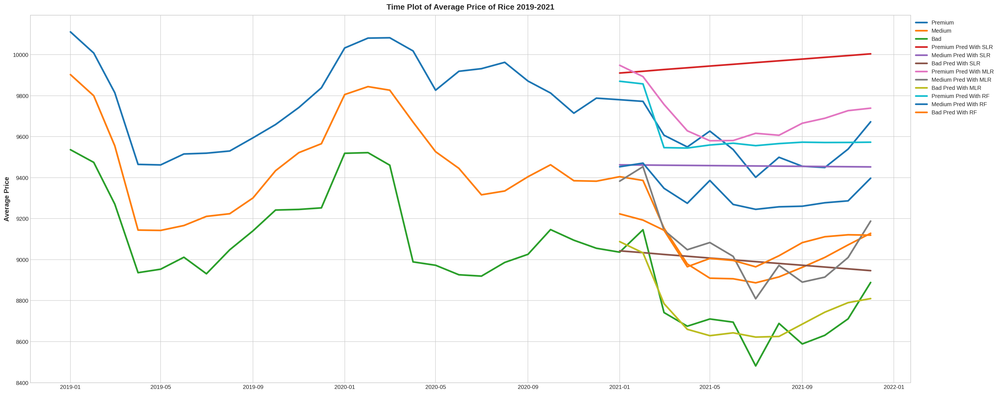

In [183]:
plt.figure(figsize=(28,12))
plt.plot(df['Average Price of Premium Quality Rice'],label='Premium') 
plt.plot(df['Average Price of Medium Quality Rice'],label='Medium') 
plt.plot(df['Average Price of Bad Quality Rice'],label='Bad')
plt.plot(AvgPricePremium_pred,label='Premium Pred With SLR')
plt.plot(AvgPriceMedium_pred,label='Medium Pred With SLR')
plt.plot(AvgPriceBad_pred,label='Bad Pred With SLR')
plt.plot(AvgPricePremium_pred_v2,label='Premium Pred With MLR')
plt.plot(AvgPriceMedium_pred_v2,label='Medium Pred With MLR')
plt.plot(AvgPriceBad_pred_v2,label='Bad Pred With MLR')
plt.plot(AvgPricePremium_pred_with_randomforest,label='Premium Pred With RF')
plt.plot(AvgPriceMedium_pred_with_randomforest,label='Medium Pred With RF')
plt.plot(AvgPriceBad_pred_with_randomforest,label='Bad Pred With RF')
plt.title('Time Plot of Average Price of Rice 2019-2021' )
plt.ylabel("Average Price")
plt.legend(bbox_to_anchor = (1.0, 1), loc = 'upper left')
plt.show()

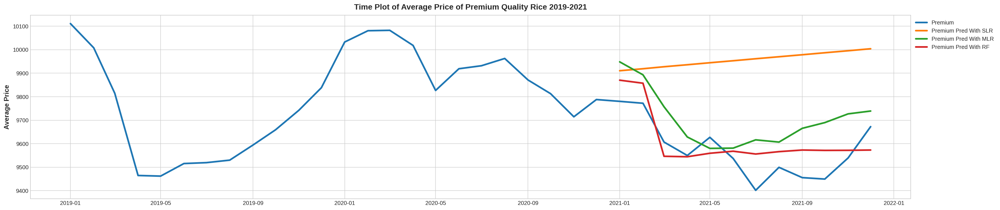

In [184]:
plt.figure(figsize=(28,6))
plt.plot(df['Average Price of Premium Quality Rice'],label='Premium') 
plt.plot(AvgPricePremium_pred,label='Premium Pred With SLR')
plt.plot(AvgPricePremium_pred_v2,label='Premium Pred With MLR')
plt.plot(AvgPricePremium_pred_with_randomforest,label='Premium Pred With RF')
plt.title('Time Plot of Average Price of Premium Quality Rice 2019-2021')
plt.ylabel("Average Price")
plt.legend(bbox_to_anchor = (1.0, 1), loc = 'upper left')
plt.show()

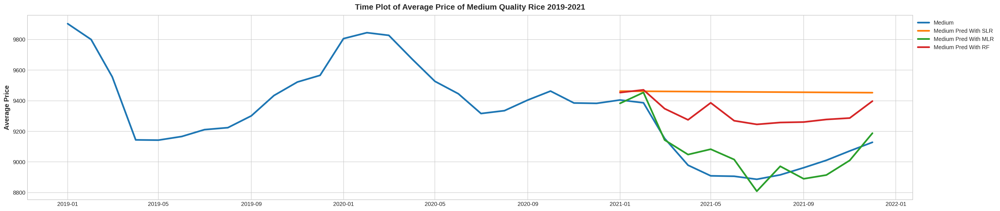

In [185]:
plt.figure(figsize=(28,6))
plt.plot(df['Average Price of Medium Quality Rice'],label='Medium') 
plt.plot(AvgPriceMedium_pred,label='Medium Pred With SLR')
plt.plot(AvgPriceMedium_pred_v2,label='Medium Pred With MLR')
plt.plot(AvgPriceMedium_pred_with_randomforest,label='Medium Pred With RF')
plt.title('Time Plot of Average Price of Medium Quality Rice 2019-2021')
plt.ylabel("Average Price")
plt.legend(bbox_to_anchor = (1.0, 1), loc = 'upper left')
plt.show()

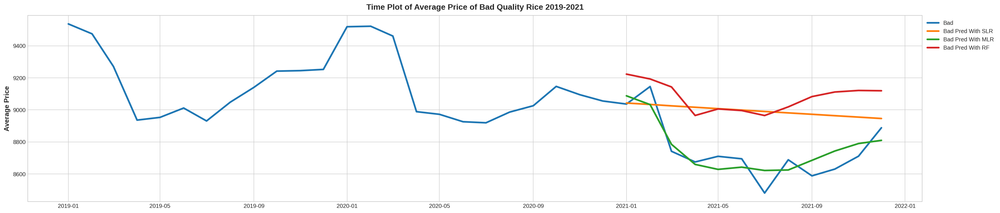

In [186]:
plt.figure(figsize=(28,6))
plt.plot(df['Average Price of Bad Quality Rice'],label='Bad')  
plt.plot(AvgPriceBad_pred,label='Bad Pred With SLR')
plt.plot(AvgPriceBad_pred_v2,label='Bad Pred With MLR')
plt.plot(AvgPriceBad_pred_with_randomforest,label='Bad Pred With RF')
plt.title('Time Plot of Average Price of Bad Quality Rice 2019-2021' )
plt.ylabel("Average Price")
plt.legend(bbox_to_anchor = (1.0, 1), loc = 'upper left')
plt.show()

Mean Absolute Error (MAE) 

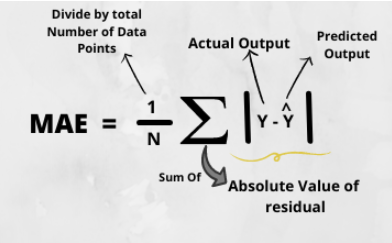

Mean Squared Error(MSE)

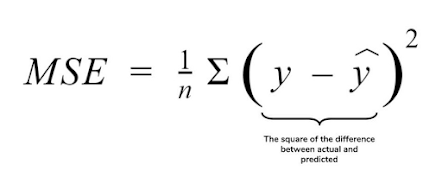

Mean Absolute Percentage Error (MAPE)

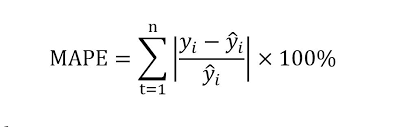

Root Mean Squared Error(RMSE) or root-mean-square deviation (RNSD)

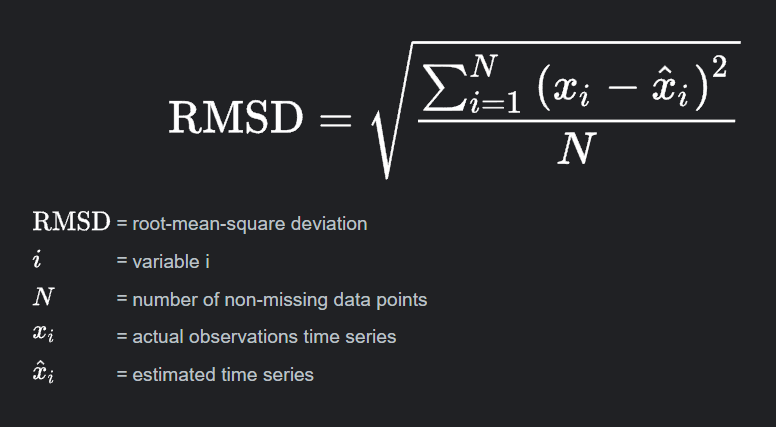


Root Mean Squared Log Error(RMSLE)

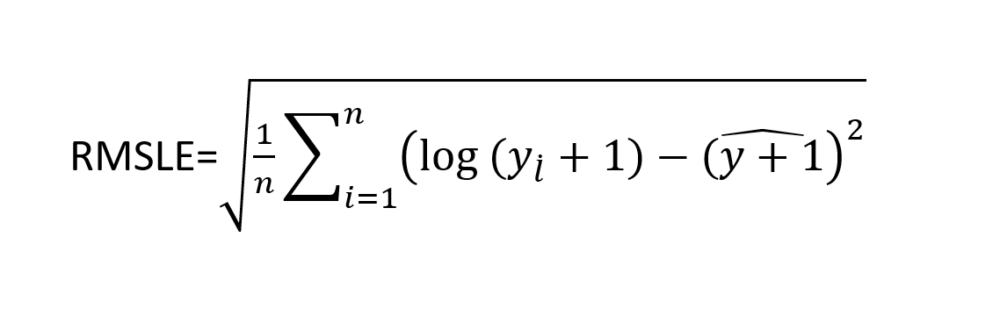

R Squared

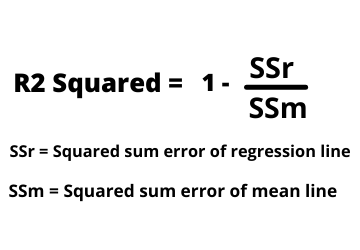

In [187]:
data_eval_train = pd.DataFrame(evaluation_train).T
data_eval_train

,MAE,MSE,MAPE,R squared,RMSE,RMSLE
Train SLR Premium,0.233959,0.075700,0.859057,0.083376,0.275136,-1.290491
Train MLR Premium,0.067261,0.008279,0.161144,0.899751,0.090990,-2.397010
Train RF Premium,0.039033,0.002605,0.095100,0.968455,0.051041,-2.975128
Train SLR Medium,0.185469,0.050945,0.396696,0.000762,0.225710,-1.488503
Train MLR Medium,0.038925,0.002676,0.078297,0.947514,0.051730,-2.961726
Train RF Medium,0.022547,0.000730,0.045646,0.985681,0.027019,-3.611197
Train SLR Bad,0.157171,0.035803,0.259943,0.084751,0.189217,-1.664863
Train MLR Bad,0.046500,0.003555,0.085626,0.909125,0.059623,-2.819720
Train RF Bad,0.028177,0.001168,0.051007,0.970149,0.034172,-3.376350


In [188]:
data_eval_test = pd.DataFrame(evaluation_test).T
data_eval_test

,MAE,MSE,MAPE,R squared,RMSE,RMSLE
Test SLR Premium,0.539802,0.327706,2.961654e+14,-11.117788,0.572456,-0.557820
Test MLR Premium,0.192091,0.045500,1.135942e+14,-0.682491,0.213308,-1.545019
Test RF Premium,0.109547,0.015330,8.170517e+13,0.433147,0.123813,-2.088985
Test SLR Medium,0.391593,0.181463,2.106280e+14,-5.340023,0.425985,-0.853352
Test MLR Medium,0.071828,0.006715,2.875866e+13,0.765392,0.081945,-2.501712
Test RF Medium,0.263488,0.082190,1.324431e+14,-1.871594,0.286688,-1.249359
Test SLR Bad,0.249975,0.079070,1.810027e+14,-1.737357,0.281195,-1.268708
Test MLR Bad,0.073271,0.006373,5.004714e+13,0.779378,0.079830,-2.527858
Test RF Bad,0.312184,0.112348,1.720223e+14,-2.889414,0.335184,-1.093075


<AxesSubplot: >

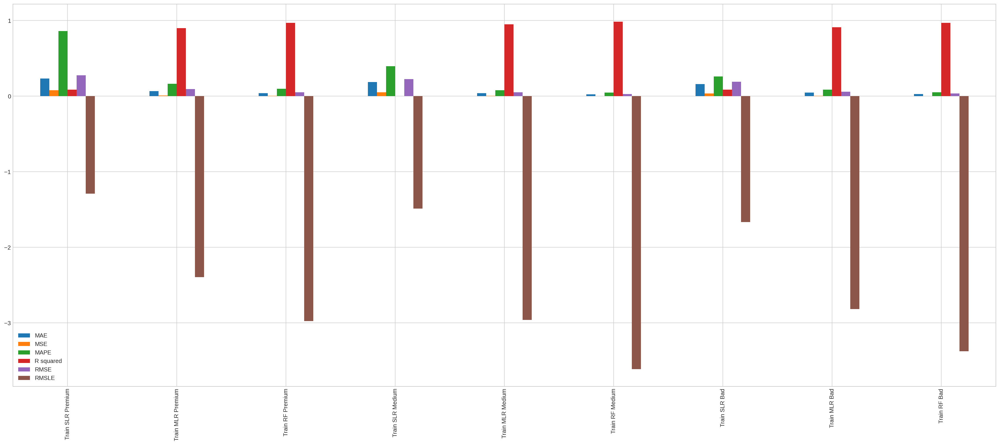

In [189]:
data_eval_train.plot(kind="bar", figsize = (30, 12))

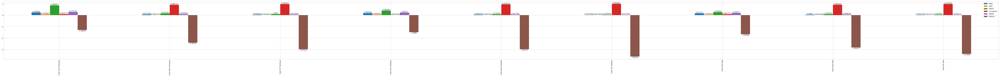

In [190]:
ax = data_eval_train.plot.bar(figsize=(100,6))

for container in ax.containers:
    ax.bar_label(container)

<AxesSubplot: >

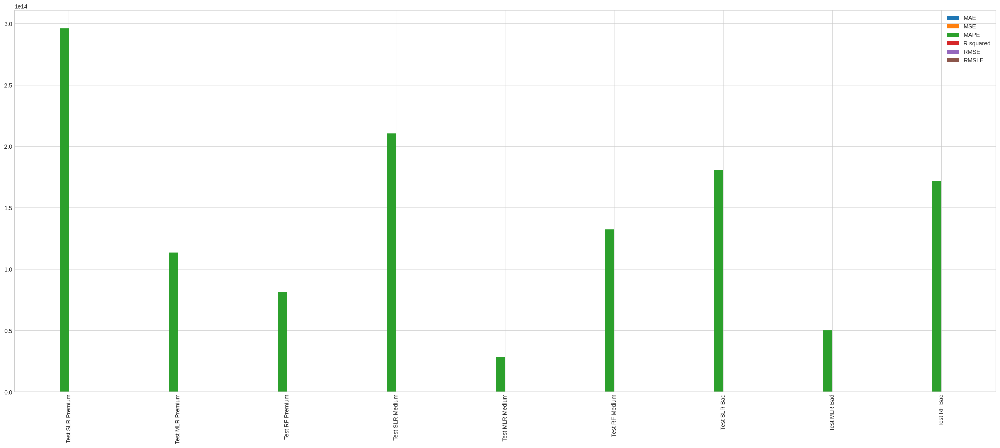

In [191]:
data_eval_test.plot(kind="bar", figsize = (30, 12))

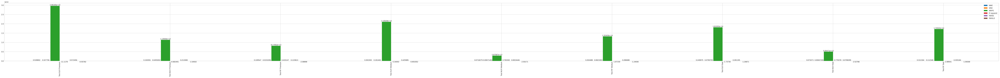

In [192]:
ax = data_eval_test.plot.bar(figsize=(100,6))

for container in ax.containers:
    ax.bar_label(container)

Training data only uses 2 years of data, from 2019-2020.

The best model for predicting the Average Price of Premium Quality Rice is Random Forest.

However, The best model for predicting the Average Price of Medium Quality Rice and Average Price of Bad Quality Rice is Multiple Linear Regression. Although the results of the metric value for model evaluation on training data show that random forest is better than Multiple Linear Regression, but on predictions on testing data in 2021 the metric value shows that Multiple Linear Regression is better than other methods.